In [1]:
import numpy as np
import pandas as pd
import scipy as sp
import scanpy as sc
import scanpy.external as sce
import anndata as ad
from glob import glob
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib as mpl
from matplotlib.pyplot import rc_context
import os
import seaborn as sns
import importlib
import re
import random

In [2]:
import degSummary
from scanpyColor import godsnot_102

In [3]:
from sklearn.metrics import classification_report
from sklearn.metrics.pairwise import cosine_similarity

from sklearn import svm
from sklearn import metrics
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

In [4]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=150, facecolor='white', dpi_save=300)

scanpy==1.8.2 anndata==0.7.5 umap==0.5.3 numpy==1.23.5 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.2.0 statsmodels==0.13.5 python-igraph==0.10.3 louvain==0.8.0 pynndescent==0.5.8


# Load data

In [5]:
os.chdir('../..')

In [6]:
pwd

'/data/tcl/Project/ADFCA'

In [7]:
age_L=['10', '20', '30']
ageColor_L=['#1F77B4', '#FF7F0E', '#2CA02C', '#D62728']
ageColor_L2=['#009ACD', '#FF7D40', '#2CA02C', '#D62728']
ggplotColor3_L= ["#F8766D", "#00BA38", "#619CFF"]
set2Color_L=["#66C2A5", "#E9936A", "#A89BB0"]

In [8]:
genotype_L=['control', 'AB42', 'hTau']

In [9]:
fcaStringentH5ad='/data/tcl/dataset/FCA/Stringent/h5ad'

In [10]:
figureFolder = 'Analysis/Figure'
os.makedirs(figureFolder, exist_ok=True)

In [11]:
figureDataFolder=f'Analysis/Figure'
os.makedirs(figureDataFolder, exist_ok=True)
figure1Folder=f'{figureDataFolder}/Figure1'
os.makedirs(figure1Folder, exist_ok=True)
figure2Folder=f'{figureDataFolder}/Figure2'
os.makedirs(figure2Folder, exist_ok=True)
figure2PicFolder=f'{figure2Folder}/pic'
os.makedirs(figure2PicFolder, exist_ok=True)

In [12]:
olfAnnotFolder=f'{figure2Folder}/olfactory_annotation'
os.makedirs(olfAnnotFolder, exist_ok=True)

olfAnnotPicFolder=f'{olfAnnotFolder}/pic'
os.makedirs(olfAnnotPicFolder, exist_ok=True)

In [13]:
cellnFolder=f'{olfAnnotFolder}/cellN'
os.makedirs(cellnFolder, exist_ok=True)

compositionFolder=f'{olfAnnotFolder}/composition'
os.makedirs(compositionFolder, exist_ok=True)

In [14]:
degControlFolder=f'{olfAnnotFolder}/DEG_toControl'
os.makedirs(degControlFolder, exist_ok=True)

degCelltypeFolder=f'{olfAnnotFolder}/DEG_celltype'
os.makedirs(degCelltypeFolder, exist_ok=True)

degSummaryFolder=f'{olfAnnotFolder}/degSummary'
os.makedirs(degSummaryFolder, exist_ok=True)

In [15]:
genoAge_L = ['control_10', 'control_20', 'control_30', 'AB42_10', 'AB42_20', 'hTau_20', 'hTau_30']

In [16]:
genoAgeSex_L = ['control_10_female', 'control_20_female', 'control_30_female', 'control_10_male', 'control_20_male', 'control_30_male', 
                'AB42_10_female', 'AB42_20_female', 'AB42_10_male', 'AB42_20_male', 
                'hTau_20_female', 'hTau_30_female', 'hTau_20_male', 'hTau_30_male']

In [17]:
# expCompare_Df = pd.read_csv(f'{cellnFolder}/expCompare_genoAge_Df.csv')
# expCompare_Df

,expSet,controlSet
0,AB42_10,control_10
1,AB42_20,control_20
2,hTau_20,control_20
3,hTau_30,control_30


In [18]:
# ageCompare_Df = pd.read_csv(f'{cellnFolder}/ageCompare_Df.csv')
# ageCompare_Df

,expSet,controlSet
0,control_20,control_10
1,control_30,control_20
2,AB42_20,AB42_10
3,hTau_30,hTau_20


In [19]:
# ageCompare
genoCompare_Df = pd.DataFrame(columns=['expSet', 'controlSet', 'age'])
# genoCompare_Df['expSet'] = [exp for exp in genoAge_L if 'control' not in exp]
# genoCompare_Df['controlSet'] = pd.Categorical(['control_' + '_'.join(genoAge.split('_')[1:]) for genoAge in genoCompare_Df['expSet']])


genoCompare_Df.loc[0,:] = ['AB42', 'control_inAB42', '10,20']
genoCompare_Df.loc[1,:] = ['hTau', 'control_inTau', '20,30']
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


# Merge FCA antenna data with all head olfactory

## Concatenate data

In [20]:
adata_antenna = sc.read(f'{fcaStringentH5ad}/s_fca_biohub_antenna_10x.h5ad').raw.to_adata()
adata_antenna

AnnData object with n_obs × n_vars = 37254 × 13203
    obs: 'age', 'batch', 'batch_id', 'celda_decontx__clusters', 'celda_decontx__contamination', 'celda_decontx__doublemad_predicted_outliers', 'dissection_lab', 'fca_id', 'fly_genetics', 'id', 'log_n_counts', 'log_n_genes', 'n_counts', 'n_genes', 'note', 'percent_mito', 'sample_id', 'scrublet__doublet_scores', 'scrublet__predicted_doublets', 'scrublet__predicted_doublets_based_on_10x_chromium_spec', 'sex', 'tissue', 'leiden_res0.4', 'leiden_res0.6', 'leiden_res0.8', 'leiden_res1.0', 'leiden_res1.2', 'leiden_res1.4', 'leiden_res1.6', 'leiden_res1.8', 'leiden_res10.0', 'leiden_res2.0', 'leiden_res4.0', 'leiden_res6.0', 'leiden_res8.0', 'annotation', 'annotation__ontology_id', 'annotation_broad', 'annotation_broad__ontology_id', 'annotation_broad_extrapolated', 'annotation_broad_extrapolated__ontology_id', 'R_annotation', 'R_annotation__ontology_id', 'R_annotation_broad', 'R_annotation_broad__ontology_id'
    var: 'ID', 'Symbol', 'Type', 

In [21]:
adata_antenna = ad.AnnData(X=adata_antenna.X, obs=adata_antenna.obs.loc[:,['age', 'sex', 'tissue', 'fly_genetics', 'n_counts', 'n_genes', 'percent_mito', 'annotation']], var=pd.DataFrame(index=adata_antenna.var.index.to_list()))
adata_antenna.obs.rename(columns={'fly_genetics': 'genotype'}, inplace=True)
adata_antenna

AnnData object with n_obs × n_vars = 37254 × 13203
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation'

In [22]:
adata_antenna.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation
index,,,,,,,,
AAACCCAAGTTGGGAC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,956.0,545,0.002090,unannotated
AAACCCACACGTCGGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,709.0,414,0.002821,unannotated
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ..."
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d
AAACCCAGTGCGACAA-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1096.0,609,0.003650,adult antenna glial cell
...,...,...,...,...,...,...,...,...
TTTGGTTTCCTGGCTT-d5543d16__FCA3_MaleFemale_Antenna,5,mix,antenna,yw; UAS-UNC84GFP,3249.0,1317,0.001538,adult olfactory receptor neuron Or67d
TTTGGTTTCGGCTATA-d5543d16__FCA3_MaleFemale_Antenna,5,mix,antenna,yw; UAS-UNC84GFP,2811.0,1148,0.002846,epithelial cell
TTTGGTTTCTGGACTA-d5543d16__FCA3_MaleFemale_Antenna,5,mix,antenna,yw; UAS-UNC84GFP,2116.0,1078,0.001417,"adult olfactory receptor neuron Or47a, Or56a a..."


In [23]:
adata_antenna.obs['dataset'] = 'FCA'

In [24]:
# adata_head=sc.read(f'Analysis/5.ADFCA_AFCA_transfer_cellbender_scDblFinder/5.4_adfca_afca_head_differentLeiden_annot.h5ad').raw.to_adata()
# adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.3/adfca_head_v0.3_woHarmony.h5ad').raw.to_adata()

adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony.h5ad').raw.to_adata()

In [25]:
adata_olfactory = adata_head[adata_head.obs.adfca_annotation == 'olfactory receptor neuron']

adata_olfactory

View of AnnData object with n_obs × n_vars = 5052 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [26]:
adata_olfactory = ad.AnnData(X=adata_olfactory.X, obs=adata_olfactory.obs.loc[:,['age', 'sex', 'tissue', 'genotype', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'adfca_annotation', 'dataset']], var=adata_olfactory.var.iloc[:,:1]  )
adata_olfactory

AnnData object with n_obs × n_vars = 5052 × 16219
    obs: 'age', 'sex', 'tissue', 'genotype', 'total_counts', 'n_genes_by_counts', 'pct_counts_mt', 'adfca_annotation', 'dataset'
    var: 'gene_ids'

In [27]:
adata_olfactory.obs.rename(columns={'adfca_annotation': 'annotation', 'n_genes_by_counts':'n_genes', 'total_counts': 'n_counts', 'pct_counts_mt':'percent_mito'}, inplace=True)

In [28]:
adata_concat = adata_antenna.concatenate(adata_olfactory, join='outer')
adata_concat

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


AnnData object with n_obs × n_vars = 42306 × 16245
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch'
    var: 'gene_ids-1'

In [29]:
adata_concat.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch
AAACCCAAGTTGGGAC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,956.0,545,0.002090,unannotated,FCA,0
AAACCCACACGTCGGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,709.0,414,0.002821,unannotated,FCA,0
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0
AAACCCAGTGCGACAA-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1096.0,609,0.003650,adult antenna glial cell,FCA,0
...,...,...,...,...,...,...,...,...,...,...
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1
CTCCACAAGTGTCATC-1_9_D20CEMH-1,20,male,head,control,512.0,355,0.390625,olfactory receptor neuron,9_D20CEMH,1


In [30]:
adata_olfactory.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset
CCTCCAAGTATGAGCG-1_11_D20CEFH,20,female,head,control,2965.0,1128,0.000000,olfactory receptor neuron,11_D20CEFH
ACGTACACACCAGCGT-1_11_D20CEFH,20,female,head,control,2886.0,1124,0.000000,olfactory receptor neuron,11_D20CEFH
CACTGAATCTGAGCAT-1_11_D20CEFH,20,female,head,control,2849.0,1066,0.000000,olfactory receptor neuron,11_D20CEFH
TCCTAATTCTGACCCT-1_11_D20CEFH,20,female,head,control,2821.0,1031,0.000000,olfactory receptor neuron,11_D20CEFH
ATATCCTAGGGAGATA-1_11_D20CEFH,20,female,head,control,2828.0,1121,0.000000,olfactory receptor neuron,11_D20CEFH
...,...,...,...,...,...,...,...,...,...
TGGATCATCAGGAGAC-1_9_D20CEMH,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH
CCCTCAATCAGCTTCC-1_9_D20CEMH,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH
AGCGTCGGTCACTTCC-1_9_D20CEMH,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH
CTCCACAAGTGTCATC-1_9_D20CEMH,20,male,head,control,512.0,355,0.390625,olfactory receptor neuron,9_D20CEMH


In [31]:
# adata_olfactory.obs.index = [obsName[:-2] for obsName in adata_olfactory.obs_names]
# adata_olfactory.obs

## HVG to tsne

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


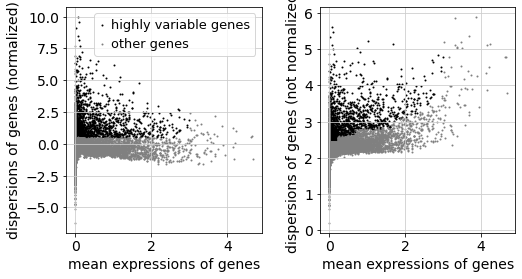

highly_variable
False    14410
True      1835
Name: count, dtype: int64

In [32]:
# HVG
sc.pp.highly_variable_genes(adata_concat, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_concat)
adata_concat.var['highly_variable'].value_counts()

In [33]:
hvg_L = adata_concat.var[ 
        (adata_concat.var.means > 0.0125) & 
        (adata_concat.var.means <= 3 ) ].dispersions_norm.sort_values(ascending=False)[:2000].index.to_list()
print('hvg #: ', len(hvg_L))
adata_concat.var['highly_variable']= [True if var in hvg_L else False for var in adata_concat.var_names ]
adata_concat.var['highly_variable'].value_counts()

hvg #:  2000


highly_variable
False    14245
True      2000
Name: count, dtype: int64

In [34]:
adata_concat.raw = adata_concat
adata_concat = adata_concat[:, adata_concat.var.highly_variable]

sc.pp.regress_out(adata_concat, ['n_counts'])
sc.pp.scale(adata_concat, max_value=10)

regressing out ['n_counts']
    sparse input is densified and may lead to high memory use


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


    finished (0:00:23)


In [35]:
adata_concat

AnnData object with n_obs × n_vars = 42306 × 2000
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg'

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:14)


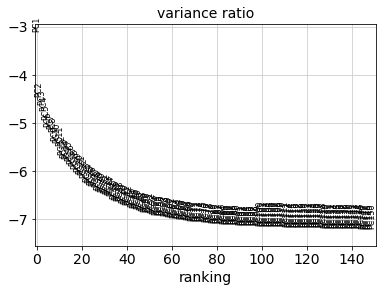

In [36]:
# PCA
sc.tl.pca(adata_concat, svd_solver='arpack', n_comps=150)
sc.pl.pca_variance_ratio(adata_concat, log=True, n_pcs=150)

In [37]:
# nn
sc.pp.neighbors(adata_concat, n_neighbors=10, n_pcs= 60)

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:21)


In [38]:
sc.tl.tsne(adata_concat, n_jobs=60, n_pcs=60)
sc.tl.umap(adata_concat)
sc.tl.leiden(adata_concat)

computing tSNE
    using 'X_pca' with n_pcs = 60
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:01:29)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:21)
running Leiden clustering
    finished: found 48 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:04)


In [39]:
adata_concat.obs.age = pd.Categorical(adata_concat.obs.age.astype(str))

In [40]:
adata_concat.write(f'{olfAnnotFolder}/olfactory_1.merge_antennaFCA.h5ad')

### plot

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


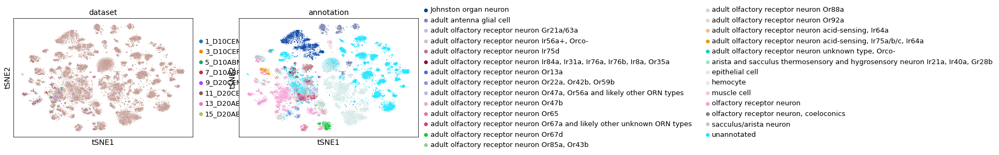

In [41]:
sc.pl.tsne(adata_concat, color=['dataset', 'annotation'])

## harmony integration

In [42]:
adata_concat = sc.read(f'{olfAnnotFolder}/olfactory_1.merge_antennaFCA.h5ad')

In [43]:
adata_concat.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,leiden
AAACCCAAGTTGGGAC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,956.0,545,0.002090,unannotated,FCA,0,42
AAACCCACACGTCGGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,709.0,414,0.002821,unannotated,FCA,0,6
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,12
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,23
AAACCCAGTGCGACAA-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1096.0,609,0.003650,adult antenna glial cell,FCA,0,2
...,...,...,...,...,...,...,...,...,...,...,...
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,34
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,33
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,32
CTCCACAAGTGTCATC-1_9_D20CEMH-1,20,male,head,control,512.0,355,0.390625,olfactory receptor neuron,9_D20CEMH,1,45


In [44]:
adata_concat.obs['dataset_tissue'] = pd.Categorical(adata_concat.obs.dataset.astype(str) + '_' + adata_concat.obs.tissue.astype(str))

In [45]:
# sce.pp.harmony_integrate(adata_concat, 'dataset_tissue')
sce.pp.harmony_integrate(adata_concat, 'genotype')

2023-10-03 17:45:25,047 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-10-03 17:46:31,415 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-10-03 17:46:31,902 - harmonypy - INFO - Iteration 1 of 10
2023-10-03 17:46:53,884 - harmonypy - INFO - Iteration 2 of 10
2023-10-03 17:47:15,077 - harmonypy - INFO - Converged after 2 iterations


In [46]:
adata_concat.obsm['X_pca'] = adata_concat.obsm['X_pca_harmony']
sc.pp.neighbors(adata_concat, n_neighbors=10, n_pcs=60)
sc.tl.umap(adata_concat)
sc.tl.tsne(adata_concat, n_pcs=60)
sc.tl.leiden(adata_concat)

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:39)
computing tSNE
    using 'X_pca' with n_pcs = 60
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:02:39)
running Leiden clustering
    finished: found 44 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:05)


In [47]:
adata_concat.write(f'{olfAnnotFolder}/olfactory_2.harmonyDatasetTissue.h5ad')
adata_concat.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_2.harmonyDatasetTissue_raw.h5ad')

### plot

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


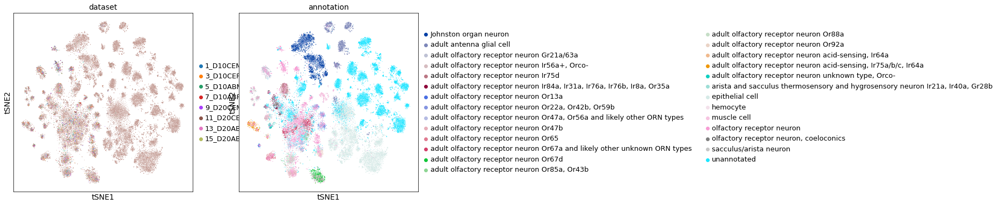

In [48]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_concat, color=['dataset', 'annotation'])

## Subset olfactory neurons 

### HVG to tsne

In [20]:
adata_concat = sc.read(f'{olfAnnotFolder}/olfactory_2.harmonyDatasetTissue.h5ad').raw.to_adata()

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


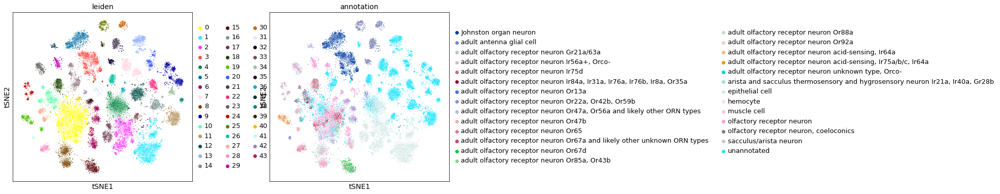

In [21]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_concat, color=['leiden', 'annotation'], wspace=0.3)

In [22]:
# selected_cluster_L = ['0', '5', '8', '9', '13', '14', '16', '18', '20', '22', '23', '24', '25', '29', '30', '31', '33', '35', '41']
# selected_cluster_L = ['0',  '7', '9', '10', '13', '15', '18', '19', '24', '25', '28', '29', '30', '35', '37', '41', '43', '44'] # Johnston organ neuron: '4', '6', '40', 
selected_cluster_L = ['0',  '6', '8', '10', '14', '15', '18', '19', '23', '24', '27', '28', '29', '35', '37', '40', '41', '42'] # Johnston organ neuron: '4', '6', '40', 

adata_concat_Olf = adata_concat[adata_concat.obs.leiden.isin(selected_cluster_L)]
adata_concat_Olf

View of AnnData object with n_obs × n_vars = 16530 × 16245
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch', 'leiden', 'dataset_tissue'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'tsne', 'umap', 'leiden_colors', 'annotation_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:540: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


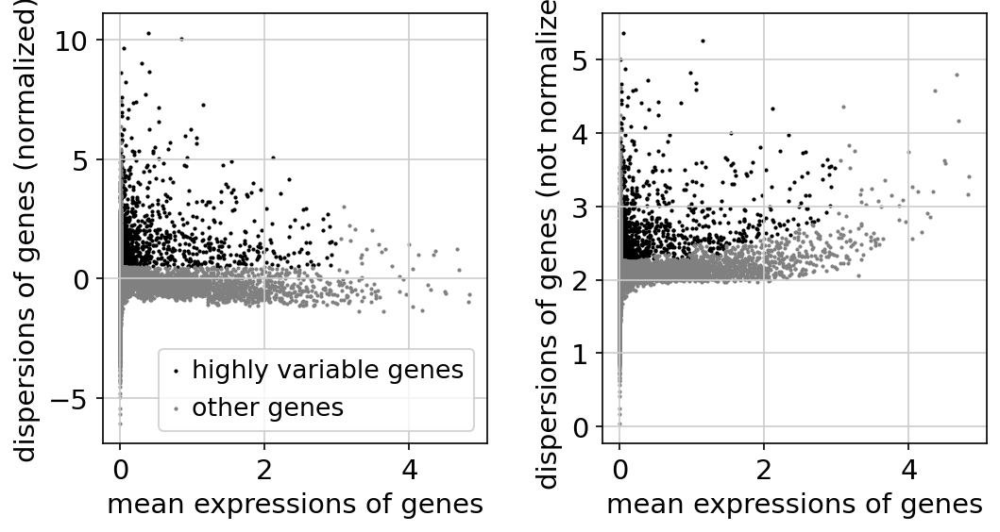

highly_variable
False    14984
True      1261
Name: count, dtype: int64

In [23]:
# HVG
sc.pp.highly_variable_genes(adata_concat_Olf, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_concat_Olf)
adata_concat_Olf.var['highly_variable'].value_counts()

In [24]:
hvg_L = adata_concat_Olf.var[ 
        (adata_concat_Olf.var.means > 0.01) & 
        (adata_concat_Olf.var.means <= 3 ) ].dispersions_norm.sort_values(ascending=False)[:2000].index.to_list()
print('hvg #: ', len(hvg_L))
adata_concat_Olf.var['highly_variable']= [True if var in hvg_L else False for var in adata_concat_Olf.var_names ]
adata_concat_Olf.var['highly_variable'].value_counts()

hvg #:  2000


highly_variable
False    14245
True      2000
Name: count, dtype: int64

In [25]:
adata_concat_Olf.raw = adata_concat_Olf
adata_concat_Olf = adata_concat_Olf[:, adata_concat_Olf.var.highly_variable]

sc.pp.regress_out(adata_concat_Olf, ['n_counts'])
sc.pp.scale(adata_concat_Olf, max_value=10)

regressing out ['n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:12)


In [26]:
adata_concat_Olf

AnnData object with n_obs × n_vars = 16530 × 2000
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch', 'leiden', 'dataset_tissue'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'neighbors', 'pca', 'tsne', 'umap', 'leiden_colors', 'annotation_colors'
    obsm: 'X_pca', 'X_pca_harmony', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

computing PCA
    on highly variable genes
    with n_comps=150
    finished (0:00:04)


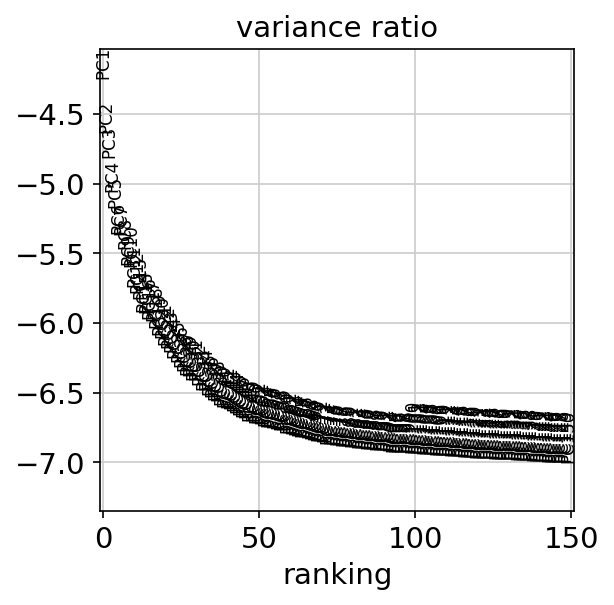

In [27]:
# PCA
sc.tl.pca(adata_concat_Olf, svd_solver='arpack', n_comps=150)
sc.pl.pca_variance_ratio(adata_concat_Olf, log=True, n_pcs=150)

In [28]:
# nn
sc.pp.neighbors(adata_concat_Olf, n_neighbors=10, n_pcs= 60)

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:19)


In [29]:
sc.tl.tsne(adata_concat_Olf, n_jobs=60, n_pcs=60)
sc.tl.umap(adata_concat_Olf)
sc.tl.leiden(adata_concat_Olf)

computing tSNE
    using 'X_pca' with n_pcs = 60
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:25)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)
running Leiden clustering
    finished: found 52 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [30]:
adata_concat_Olf.write(f'{olfAnnotFolder}/olfactory_3.adata_concat_Olf.h5ad')

### plot

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


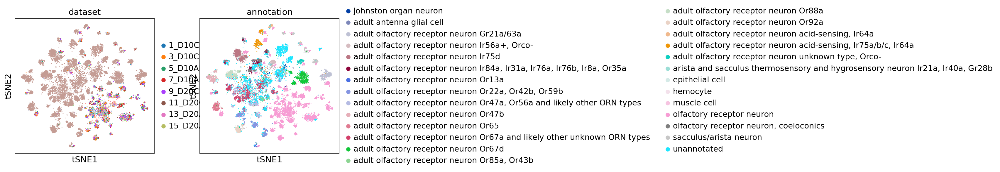

In [31]:
sc.pl.tsne(adata_concat_Olf, color=['dataset', 'annotation'])

### harmony integration

In [32]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_3.adata_concat_Olf.h5ad')

In [33]:
adata_concat_Olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,leiden,dataset_tissue
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,15,FCA_antenna
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,4,FCA_antenna
AAACCCATCACCCATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1762.0,964,0.000567,adult olfactory receptor neuron Or67d,FCA,0,7,FCA_antenna
AAACGAATCGGAATGG-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1157.0,629,0.001729,unannotated,FCA,0,27,FCA_antenna
AAACGCTCAGGCGAAT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1429.0,886,0.011888,unannotated,FCA,0,13,FCA_antenna
...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH-1,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,32,9_D20CEMH_head
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,11,9_D20CEMH_head
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,20,9_D20CEMH_head
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,23,9_D20CEMH_head


In [34]:
# sce.pp.harmony_integrate(adata_concat_Olf, 'dataset_tissue')
sce.pp.harmony_integrate(adata_concat_Olf, 'genotype')

2023-10-04 15:28:49,644 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-10-04 15:28:58,077 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-10-04 15:28:58,171 - harmonypy - INFO - Iteration 1 of 10
2023-10-04 15:29:01,648 - harmonypy - INFO - Iteration 2 of 10
2023-10-04 15:29:05,084 - harmonypy - INFO - Converged after 2 iterations


In [35]:
adata_concat_Olf.obsm['X_pca'] = adata_concat_Olf.obsm['X_pca_harmony']
sc.pp.neighbors(adata_concat_Olf, n_neighbors=10, n_pcs=60)
sc.tl.umap(adata_concat_Olf)
sc.tl.tsne(adata_concat_Olf, n_pcs=60)
sc.tl.leiden(adata_concat_Olf)

computing neighbors
    using 'X_pca' with n_pcs = 60
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)
computing tSNE
    using 'X_pca' with n_pcs = 60
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:24)
running Leiden clustering
    finished: found 44 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [36]:
adata_concat_Olf.write(f'{olfAnnotFolder}/olfactory_4.adata_concat_Olf_harmonyDatasetTissue.h5ad')
adata_concat_Olf.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_4.adata_concat_Olf_harmonyDatasetTissue_raw.h5ad')

### plot

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


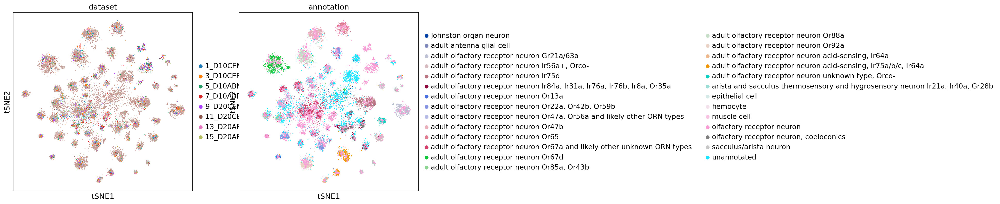

In [37]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_concat_Olf, color=['dataset', 'annotation'])

## Annotate olfactory neuron

In [38]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_4.adata_concat_Olf_harmonyDatasetTissue.h5ad')

In [39]:
adata_adfca_Olf = adata_concat_Olf[adata_concat_Olf.obs.genotype.isin(['AB42', 'control', 'hTau'])].raw.to_adata()
adata_adfca_Olf

AnnData object with n_obs × n_vars = 4896 × 16245
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch', 'leiden', 'dataset_tissue'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'annotation_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_tsne', 'X_umap'
    obsp: 'connectivities', 'distances'

### Add different leiden resolution

In [40]:
for leiden in np.arange(1.0, 7.0, 1.0):
    print(leiden)
    sc.tl.leiden(adata_concat_Olf, resolution=leiden, key_added=f'leiden_{leiden}' )

1.0
running Leiden clustering
    finished: found 44 clusters and added
    'leiden_1.0', the cluster labels (adata.obs, categorical) (0:00:00)
2.0
running Leiden clustering
    finished: found 52 clusters and added
    'leiden_2.0', the cluster labels (adata.obs, categorical) (0:00:00)
3.0
running Leiden clustering
    finished: found 59 clusters and added
    'leiden_3.0', the cluster labels (adata.obs, categorical) (0:00:00)
4.0
running Leiden clustering
    finished: found 67 clusters and added
    'leiden_4.0', the cluster labels (adata.obs, categorical) (0:00:00)
5.0
running Leiden clustering
    finished: found 75 clusters and added
    'leiden_5.0', the cluster labels (adata.obs, categorical) (0:00:00)
6.0
running Leiden clustering
    finished: found 78 clusters and added
    'leiden_6.0', the cluster labels (adata.obs, categorical) (0:00:00)


In [41]:
adata_concat_Olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,leiden,dataset_tissue,leiden_1.0,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,8,FCA_antenna,8,15,14,12,10,10
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,5,FCA_antenna,5,3,1,38,39,38
AAACCCATCACCCATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1762.0,964,0.000567,adult olfactory receptor neuron Or67d,FCA,0,1,FCA_antenna,1,1,0,0,47,53
AAACGAATCGGAATGG-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1157.0,629,0.001729,unannotated,FCA,0,29,FCA_antenna,29,31,30,33,33,32
AAACGCTCAGGCGAAT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1429.0,886,0.011888,unannotated,FCA,0,6,FCA_antenna,6,4,2,1,0,45
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH-1,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,31,9_D20CEMH_head,31,32,32,36,34,33
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,14,9_D20CEMH_head,14,12,12,8,7,6
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,24,9_D20CEMH_head,24,23,24,25,26,23
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,26,9_D20CEMH_head,26,26,31,30,35,34


### Logistic regression

In [42]:
adata_concat_Olf.obs['true']=\
    adata_concat_Olf.obs.annotation[
    adata_concat_Olf.obs.dataset_tissue == 'FCA_antenna']

In [43]:
adata_ref = adata_concat_Olf[adata_concat_Olf.obs.dataset_tissue == 'FCA_antenna']
adata_query=adata_concat_Olf[adata_concat_Olf.obs.dataset_tissue != 'FCA_antenna']

In [44]:
X_test = adata_query.obsm['X_pca']
X_train = adata_ref.obsm['X_pca']
y_train = list(adata_ref.obs.true)
clf = LogisticRegression(random_state=1, max_iter=5000)
clf.fit(X_train, y_train)
preds_ct = clf.predict(X_test)

In [45]:
adata_query.obs['true'] = pd.Categorical(preds_ct)
new_annot = dict(zip(adata_query.obs_names, adata_query.obs.true))
adata_query.obs['true'] = pd.Categorical(
    [new_annot[c] if c in new_annot else adata_query.obs.true[i] 
     for i, c in enumerate(adata_query.obs_names)])
mapping_D = dict(zip(adata_query.obs_names, adata_query.obs['true']))

<ipython-input-45-c0a02a8d897d>:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_query.obs['true'] = pd.Categorical(preds_ct)


In [46]:
adata_concat_Olf.obs['linearR_annotation']= \
    pd.Categorical([ mapping_D[obs] if obs in mapping_D.keys() else adata_concat_Olf.obs.loc[obs, 'annotation'] for obs in adata_concat_Olf.obs_names])

In [47]:
adata_concat_Olf.write(f'{olfAnnotFolder}/olfactory_5.adata_concat_Olf_linearR_annotation.h5ad')
adata_concat_Olf.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_5.adata_concat_Olf_linearR_annotation_raw.h5ad')

### Add annotation: adfca_annotation_olfactory

In [20]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_5.adata_concat_Olf_linearR_annotation.h5ad')

In [21]:
adata_concat_Olf.obs.linearR_annotation.value_counts()

linearR_annotation
unannotated                                                                      4817
adult olfactory receptor neuron Or67a and likely other unknown ORN types         2048
adult olfactory receptor neuron Or22a, Or42b, Or59b                               983
adult olfactory receptor neuron Or67d                                             974
adult olfactory receptor neuron Or47a, Or56a and likely other ORN types           798
adult olfactory receptor neuron Ir75d                                             736
adult olfactory receptor neuron Or88a                                             716
adult olfactory receptor neuron Gr21a/63a                                         609
adult olfactory receptor neuron Or47b                                             605
sacculus/arista neuron                                                            598
adult olfactory receptor neuron acid-sensing, Ir75a/b/c, Ir64a                    580
adult olfactory receptor neuron Or6

In [22]:
### Read annotation csv
annot_Df = pd.read_csv(f'{olfAnnotFolder}/annot_olf.csv')
# annot_D = dict( zip(annot_Df['leiden_1.5'].astype(str), annot_Df['annotation']) )
annot_D = dict( zip(annot_Df['leiden_3.0'].astype(str), annot_Df['annotation']) )
annot_Df.head()

,leiden_3.0,annotation
0,0,adult olfactory receptor neuron Or67d
1,1,adult olfactory receptor neuron Ir75d
2,2,adult olfactory receptor neuron Or88a
3,3,"adult olfactory receptor neuron Or49b, Or67b, ..."
4,4,adult olfactory receptor neuron Or47b


In [23]:
adata_concat_Olf.obs['adfca_annotation_olfactory'] = [annot_D[leiden] for leiden in adata_concat_Olf.obs['leiden_3.0']]
adata_concat_Olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,...,dataset_tissue,leiden_1.0,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0,true,linearR_annotation,adfca_annotation_olfactory
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,...,FCA_antenna,8,15,14,12,10,10,"adult olfactory receptor neuron Or22a, Or42b, ...","adult olfactory receptor neuron Or22a, Or42b, ...",adult olfactory receptor neuron Or42b
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,...,FCA_antenna,5,3,1,38,39,38,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d
AAACCCATCACCCATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1762.0,964,0.000567,adult olfactory receptor neuron Or67d,FCA,0,...,FCA_antenna,1,1,0,0,47,53,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d
AAACGAATCGGAATGG-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1157.0,629,0.001729,unannotated,FCA,0,...,FCA_antenna,29,31,30,33,33,32,unannotated,unannotated,"adult olfactory receptor neuron Ir92a, Ir84a, ..."
AAACGCTCAGGCGAAT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1429.0,886,0.011888,unannotated,FCA,0,...,FCA_antenna,6,4,2,1,0,45,unannotated,unannotated,adult olfactory receptor neuron Or88a
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH-1,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,31,32,32,36,34,33,NaN,unannotated,adult olfactory receptor neuron
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,14,12,12,8,7,6,NaN,adult olfactory receptor neuron Or65,adult olfactory receptor neuron Or65a/b/c
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,24,23,24,25,26,23,NaN,"adult olfactory receptor neuron unknown type, ...",adult olfactory receptor neuron Ir56a
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,26,26,31,30,35,34,NaN,unannotated,adult olfactory receptor neuron


In [24]:
adata_concat_Olf.write(f'{olfAnnotFolder}/olfactory_6.adata_concat_Olf_manualAnnot.h5ad')
adata_concat_Olf.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_6.adata_concat_Olf_manualAnnot_raw.h5ad')

### Plot annotated ORN

In [51]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_6.adata_concat_Olf_manualAnnot.h5ad')

In [52]:
adata_concat_Olf

AnnData object with n_obs × n_vars = 16530 × 2000
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch', 'leiden', 'dataset_tissue', 'leiden_1.0', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'true', 'linearR_annotation', 'adfca_annotation_olfactory'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'annotation_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [53]:
len(pd.DataFrame(adata_concat_Olf.obs.adfca_annotation_olfactory.value_counts()))

38

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


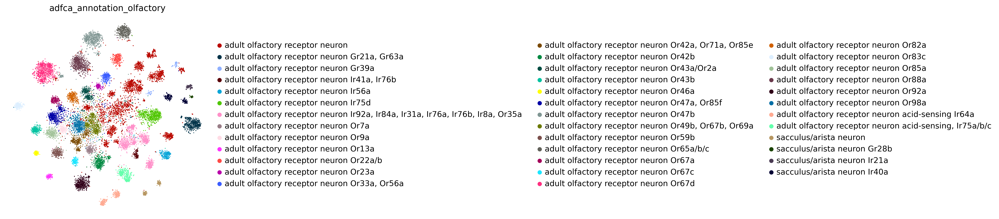

In [67]:
with rc_context({'figure.figsize': (6, 6)}):
    sc.pl.tsne(adata_concat_Olf, color=['adfca_annotation_olfactory'], frameon=False, 
               save=f'_adata_concat_Olf_adfca_annotation_olfactory.pdf') # 

In [65]:
random.shuffle(adata_concat_Olf.uns['adfca_annotation_olfactory_colors'])

In [68]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{olfAnnotPicFolder}/{x}')

### check cell composition, ORG expression in ADFCA data

In [27]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_6.adata_concat_Olf_manualAnnot.h5ad')

In [28]:
adata_concat_Olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   3320
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a    1117
adult olfactory receptor neuron Or67d                                              843
adult olfactory receptor neuron Or47b                                              734
adult olfactory receptor neuron Ir75d                                              686
adult olfactory receptor neuron Or88a                                              646
adult olfactory receptor neuron Or49b, Or67b, Or69a                                613
adult olfactory receptor neuron Gr21a, Gr63a                                       566
adult olfactory receptor neuron Or47a, Or85f                                       512
adult olfactory receptor neuron Or98a                                              507
adult olfactory receptor neuron Or92a                                              487
adult olfactory receptor neuron Or65a/b/c  

In [29]:
adata_adfca_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony.h5ad')
adata_adfca_head

AnnData object with n_obs × n_vars = 360036 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [30]:
adata_concat_Olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,...,dataset_tissue,leiden_1.0,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0,true,linearR_annotation,adfca_annotation_olfactory
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,...,FCA_antenna,8,15,14,12,10,10,"adult olfactory receptor neuron Or22a, Or42b, ...","adult olfactory receptor neuron Or22a, Or42b, ...",adult olfactory receptor neuron Or42b
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,...,FCA_antenna,5,3,1,38,39,38,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d
AAACCCATCACCCATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1762.0,964,0.000567,adult olfactory receptor neuron Or67d,FCA,0,...,FCA_antenna,1,1,0,0,47,53,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d
AAACGAATCGGAATGG-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1157.0,629,0.001729,unannotated,FCA,0,...,FCA_antenna,29,31,30,33,33,32,unannotated,unannotated,"adult olfactory receptor neuron Ir92a, Ir84a, ..."
AAACGCTCAGGCGAAT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2-0,5,male,antenna,W1118,1429.0,886,0.011888,unannotated,FCA,0,...,FCA_antenna,6,4,2,1,0,45,unannotated,unannotated,adult olfactory receptor neuron Or88a
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH-1,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,31,32,32,36,34,33,NaN,unannotated,adult olfactory receptor neuron
TGGATCATCAGGAGAC-1_9_D20CEMH-1,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,14,12,12,8,7,6,NaN,adult olfactory receptor neuron Or65,adult olfactory receptor neuron Or65a/b/c
CCCTCAATCAGCTTCC-1_9_D20CEMH-1,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,24,23,24,25,26,23,NaN,"adult olfactory receptor neuron unknown type, ...",adult olfactory receptor neuron Ir56a
AGCGTCGGTCACTTCC-1_9_D20CEMH-1,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,26,26,31,30,35,34,NaN,unannotated,adult olfactory receptor neuron


In [31]:
adata_adfca_olf = adata_concat_Olf[adata_concat_Olf.obs.genotype.isin(['AB42', 'control', 'hTau'])]
adata_adfca_olf

View of AnnData object with n_obs × n_vars = 4896 × 2000
    obs: 'age', 'sex', 'tissue', 'genotype', 'n_counts', 'n_genes', 'percent_mito', 'annotation', 'dataset', 'batch', 'leiden', 'dataset_tissue', 'leiden_1.0', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'true', 'linearR_annotation', 'adfca_annotation_olfactory'
    var: 'gene_ids-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'annotation_colors', 'hvg', 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [32]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1139
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Gr21a, Gr63a                                       130
adult olfactory receptor neuron Or42b      

In [33]:
adata_adfca_olf.obs.index = [obs[:-2] for obs in adata_adfca_olf.obs_names]
adata_adfca_olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,...,dataset_tissue,leiden_1.0,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0,true,linearR_annotation,adfca_annotation_olfactory
CCTCCAAGTATGAGCG-1_11_D20CEFH,20,female,head,control,2965.0,1128,0.000000,olfactory receptor neuron,11_D20CEFH,1,...,11_D20CEFH_head,25,25,41,60,64,67,NaN,unannotated,adult olfactory receptor neuron Gr39a
ACGTACACACCAGCGT-1_11_D20CEFH,20,female,head,control,2886.0,1124,0.000000,olfactory receptor neuron,11_D20CEFH,1,...,11_D20CEFH_head,17,14,16,11,11,11,NaN,unannotated,adult olfactory receptor neuron
CACTGAATCTGAGCAT-1_11_D20CEFH,20,female,head,control,2849.0,1066,0.000000,olfactory receptor neuron,11_D20CEFH,1,...,11_D20CEFH_head,17,14,16,11,11,11,NaN,unannotated,adult olfactory receptor neuron
TCCTAATTCTGACCCT-1_11_D20CEFH,20,female,head,control,2821.0,1031,0.000000,olfactory receptor neuron,11_D20CEFH,1,...,11_D20CEFH_head,22,21,22,24,25,21,NaN,"adult olfactory receptor neuron Or22a, Or42b, ...",adult olfactory receptor neuron Or59b
ATATCCTAGGGAGATA-1_11_D20CEFH,20,female,head,control,2828.0,1121,0.000000,olfactory receptor neuron,11_D20CEFH,1,...,11_D20CEFH_head,17,14,16,11,11,11,NaN,unannotated,adult olfactory receptor neuron
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,31,32,32,36,34,33,NaN,unannotated,adult olfactory receptor neuron
TGGATCATCAGGAGAC-1_9_D20CEMH,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,14,12,12,8,7,6,NaN,adult olfactory receptor neuron Or65,adult olfactory receptor neuron Or65a/b/c
CCCTCAATCAGCTTCC-1_9_D20CEMH,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,24,23,24,25,26,23,NaN,"adult olfactory receptor neuron unknown type, ...",adult olfactory receptor neuron Ir56a
AGCGTCGGTCACTTCC-1_9_D20CEMH,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,26,26,31,30,35,34,NaN,unannotated,adult olfactory receptor neuron


In [33]:
annot_D = dict(zip(adata_adfca_olf.obs_names, adata_adfca_olf.obs['adfca_annotation_olfactory']))

In [34]:
adata_adfca_head.obs['adfca_annotation_olfactory'] = pd.Categorical([annot_D[obs] if obs in annot_D.keys() else adata_adfca_head.obs['adfca_annotation'][n] for n, obs in enumerate(adata_adfca_head.obs_names)])

In [35]:
adata_adfca_head.obs

,latent_RT_efficiency,latent_cell_probability,latent_scale,n_genes,dataset,cellBC,sex,tissue,age,genotype,...,leiden_4.0,leiden_5.0,leiden_6.0,leiden_7.0,leiden_8.0,leiden_9.0,leiden_10.0,adfca_annotation_group,adfca_annotation_group2,adfca_annotation_olfactory
TTCGCTGTCCCAAGCG-1_11_D20CEFH,1.632454,0.999480,1554.837524,1033,11_D20CEFH,TTCGCTGTCCCAAGCG-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
CTCAATTAGACCACGA-1_11_D20CEFH,1.660071,0.999592,1568.089233,1043,11_D20CEFH,CTCAATTAGACCACGA-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
GCTACCTTCACCCTCA-1_11_D20CEFH,1.954348,0.999656,1626.214355,1034,11_D20CEFH,GCTACCTTCACCCTCA-1,female,head,20,control,...,7,4,3,3,2,5,141,muscle cell ungrouped,skeletal muscle of head,skeletal muscle of head
AGGGTGAGTGCCGTTG-1_11_D20CEFH,1.628265,0.999738,1579.643555,1150,11_D20CEFH,AGGGTGAGTGCCGTTG-1,female,head,20,control,...,13,210,227,245,267,287,301,hemocyte,hemocyte,hemocyte_head
ATTGTTCTCAGTCATG-1_11_D20CEFH,1.493281,0.999731,1566.443604,972,11_D20CEFH,ATTGTTCTCAGTCATG-1,female,head,20,control,...,3,2,2,1,15,24,14,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CAACGGCGTCGTGGAA-1_9_D20CEMH,0.542235,0.996761,1592.519409,324,9_D20CEMH,CAACGGCGTCGTGGAA-1,male,head,20,control,...,51,55,52,53,49,47,41,lamina neuron,lamina neuron,lamina monopolar neuron L1
CGTTCTGAGTTTGTCG-1_9_D20CEMH,0.542307,0.995080,1609.327393,402,9_D20CEMH,CGTTCTGAGTTTGTCG-1,male,head,20,control,...,70,70,69,67,66,67,63,sensory neuron ungrouped,olfactory receptor neuron,olfactory receptor neuron
CTATAGGCACATTGTG-1_9_D20CEMH,0.543580,0.993411,1608.768188,370,9_D20CEMH,CTATAGGCACATTGTG-1,male,head,20,control,...,156,163,94,98,97,216,153,glial cell ungrouped,subperineurial glial cell,subperineurial glial cell_head
CGAGTTAAGAGGCTGT-1_9_D20CEMH,0.535387,0.991753,1576.863525,361,9_D20CEMH,CGAGTTAAGAGGCTGT-1,male,head,20,control,...,5,3,4,5,4,3,5,CNS neuron ungrouped,uncharacterized CNS neuron,uncharacterized CNS neuron


### Check Gr21a cluster

In [38]:
'adult olfactory receptor neuron Gr21a, Gr63a' in adata_adfca_head.obs.adfca_annotation_olfactory.to_list()

True

In [39]:
adata_adfca_head[adata_adfca_head.obs.adfca_annotation_olfactory == 'adult olfactory receptor neuron Gr21a, Gr63a']

View of AnnData object with n_obs × n_vars = 130 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


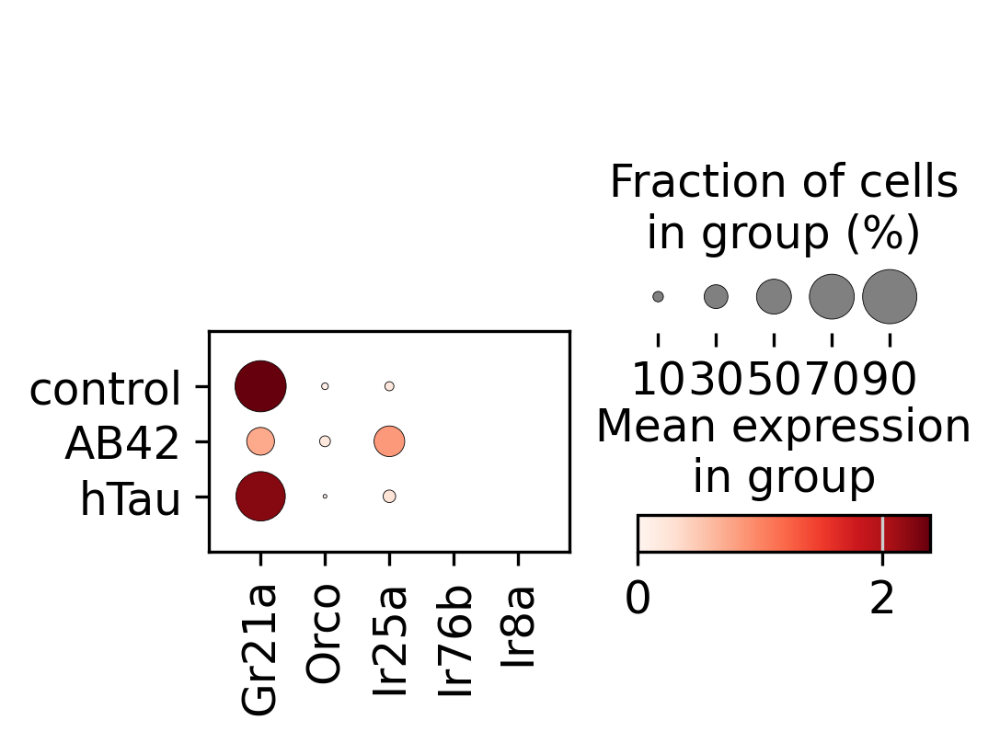

In [43]:
sc.pl.dotplot(adata_adfca_head[adata_adfca_head.obs.adfca_annotation_olfactory == 'adult olfactory receptor neuron Gr21a, Gr63a'], var_names=['Gr21a', 'Orco', 'Ir25a', 'Ir76b', 'Ir8a'], groupby='genotype')

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


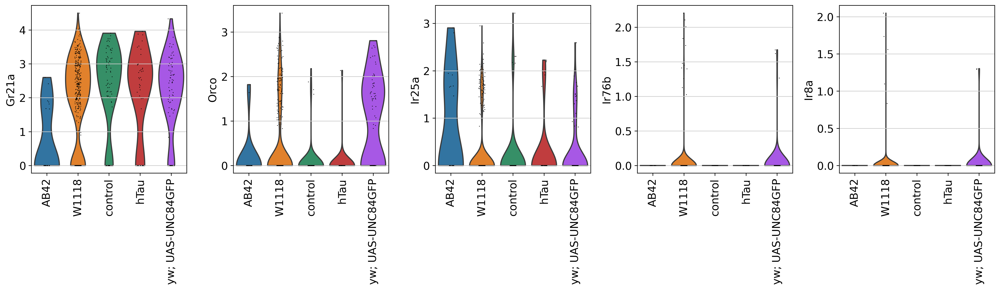

In [71]:
sc.pl.violin(adata_concat_Olf[adata_concat_Olf.obs.adfca_annotation_olfactory == 'adult olfactory receptor neuron Gr21a, Gr63a'], keys=['Gr21a', 'Orco', 'Ir25a', 'Ir76b', 'Ir8a'], groupby='genotype', rotation=90)

## Use ADFCA "olfactory receptor neuron": HVG to tsne

In [20]:
adata_concat_Olf = sc.read(f'{olfAnnotFolder}/olfactory_6.adata_concat_Olf_manualAnnot.h5ad')

In [21]:
adata_adfca_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony.h5ad')
adata_adfca_head

AnnData object with n_obs × n_vars = 360036 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [22]:
adata_concat_Olf.obs.index = [obs[:-2] for obs in adata_concat_Olf.obs_names]
adata_concat_Olf.obs

,age,sex,tissue,genotype,n_counts,n_genes,percent_mito,annotation,dataset,batch,...,dataset_tissue,leiden_1.0,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0,true,linearR_annotation,adfca_annotation_olfactory
AAACCCAGTAGTAAGT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1585.0,857,0.004416,"adult olfactory receptor neuron Or22a, Or42b, ...",FCA,0,...,FCA_antenna,8,15,14,12,10,10,"adult olfactory receptor neuron Or22a, Or42b, ...","adult olfactory receptor neuron Or22a, Or42b, ...",adult olfactory receptor neuron Or42b
AAACCCAGTGACTATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,3383.0,1490,0.003547,adult olfactory receptor neuron Ir75d,FCA,0,...,FCA_antenna,5,3,1,38,39,38,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d,adult olfactory receptor neuron Ir75d
AAACCCATCACCCATC-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1762.0,964,0.000567,adult olfactory receptor neuron Or67d,FCA,0,...,FCA_antenna,1,1,0,0,47,53,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d,adult olfactory receptor neuron Or67d
AAACGAATCGGAATGG-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1157.0,629,0.001729,unannotated,FCA,0,...,FCA_antenna,29,31,30,33,33,32,unannotated,unannotated,"adult olfactory receptor neuron Ir92a, Ir84a, ..."
AAACGCTCAGGCGAAT-6e294c34__FCA55_Male_antenna_adult_5dWT_Luo_sample2,5,male,antenna,W1118,1429.0,886,0.011888,unannotated,FCA,0,...,FCA_antenna,6,4,2,1,0,45,unannotated,unannotated,adult olfactory receptor neuron Or88a
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CACTGAAAGTGTGTTC-1_9_D20CEMH,20,male,head,control,631.0,438,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,31,32,32,36,34,33,NaN,unannotated,adult olfactory receptor neuron
TGGATCATCAGGAGAC-1_9_D20CEMH,20,male,head,control,568.0,372,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,14,12,12,8,7,6,NaN,adult olfactory receptor neuron Or65,adult olfactory receptor neuron Or65a/b/c
CCCTCAATCAGCTTCC-1_9_D20CEMH,20,male,head,control,533.0,369,0.375235,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,24,23,24,25,26,23,NaN,"adult olfactory receptor neuron unknown type, ...",adult olfactory receptor neuron Ir56a
AGCGTCGGTCACTTCC-1_9_D20CEMH,20,male,head,control,540.0,341,0.000000,olfactory receptor neuron,9_D20CEMH,1,...,9_D20CEMH_head,26,26,31,30,35,34,NaN,unannotated,adult olfactory receptor neuron


In [23]:
olf_annot_D = dict(zip(adata_concat_Olf.obs.index, adata_concat_Olf.obs.adfca_annotation_olfactory))

In [24]:
adata_adfca_head.obs['adfca_annotation_olfactory'] = pd.Categorical([olf_annot_D[obs] if obs in olf_annot_D.keys() else adata_adfca_head.obs.adfca_annotation[n] for n, obs in enumerate(adata_adfca_head.obs_names)])
adata_adfca_head.obs

,latent_RT_efficiency,latent_cell_probability,latent_scale,n_genes,dataset,cellBC,sex,tissue,age,genotype,...,leiden_4.0,leiden_5.0,leiden_6.0,leiden_7.0,leiden_8.0,leiden_9.0,leiden_10.0,adfca_annotation_group,adfca_annotation_group2,adfca_annotation_olfactory
TTCGCTGTCCCAAGCG-1_11_D20CEFH,1.632454,0.999480,1554.837524,1033,11_D20CEFH,TTCGCTGTCCCAAGCG-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
CTCAATTAGACCACGA-1_11_D20CEFH,1.660071,0.999592,1568.089233,1043,11_D20CEFH,CTCAATTAGACCACGA-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
GCTACCTTCACCCTCA-1_11_D20CEFH,1.954348,0.999656,1626.214355,1034,11_D20CEFH,GCTACCTTCACCCTCA-1,female,head,20,control,...,7,4,3,3,2,5,141,muscle cell ungrouped,skeletal muscle of head,skeletal muscle of head
AGGGTGAGTGCCGTTG-1_11_D20CEFH,1.628265,0.999738,1579.643555,1150,11_D20CEFH,AGGGTGAGTGCCGTTG-1,female,head,20,control,...,13,210,227,245,267,287,301,hemocyte,hemocyte,hemocyte_head
ATTGTTCTCAGTCATG-1_11_D20CEFH,1.493281,0.999731,1566.443604,972,11_D20CEFH,ATTGTTCTCAGTCATG-1,female,head,20,control,...,3,2,2,1,15,24,14,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CAACGGCGTCGTGGAA-1_9_D20CEMH,0.542235,0.996761,1592.519409,324,9_D20CEMH,CAACGGCGTCGTGGAA-1,male,head,20,control,...,51,55,52,53,49,47,41,lamina neuron,lamina neuron,lamina monopolar neuron L1
CGTTCTGAGTTTGTCG-1_9_D20CEMH,0.542307,0.995080,1609.327393,402,9_D20CEMH,CGTTCTGAGTTTGTCG-1,male,head,20,control,...,70,70,69,67,66,67,63,sensory neuron ungrouped,olfactory receptor neuron,olfactory receptor neuron
CTATAGGCACATTGTG-1_9_D20CEMH,0.543580,0.993411,1608.768188,370,9_D20CEMH,CTATAGGCACATTGTG-1,male,head,20,control,...,156,163,94,98,97,216,153,glial cell ungrouped,subperineurial glial cell,subperineurial glial cell_head
CGAGTTAAGAGGCTGT-1_9_D20CEMH,0.535387,0.991753,1576.863525,361,9_D20CEMH,CGAGTTAAGAGGCTGT-1,male,head,20,control,...,5,3,4,5,4,3,5,CNS neuron ungrouped,uncharacterized CNS neuron,uncharacterized CNS neuron


In [25]:
adata_adfca_olf = adata_adfca_head[adata_adfca_head.obs.adfca_annotation == 'olfactory receptor neuron'].raw.to_adata()
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 16219
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [26]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts() # some neurons are with "olfactory receptor neuron" annotation instead of "adult olfactory receptor neuron "

adult olfactory receptor neuron                                                   1139
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
olfactory receptor neuron                                                          156
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Gr21a, Gr63

In [27]:
adata_adfca_olf.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron' if annot == 'olfactory receptor neuron' else annot  for annot in adata_adfca_olf.obs.adfca_annotation_olfactory ])

In [28]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1295
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Gr21a, Gr63a                                       130
adult olfactory receptor neuron Or42b      

In [29]:
adata_adfca_head.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron' if annot == 'olfactory receptor neuron' else annot  for annot in adata_adfca_head.obs.adfca_annotation_olfactory ])

In [71]:
adata_adfca_olf.uns['log1p']["base"] = None

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


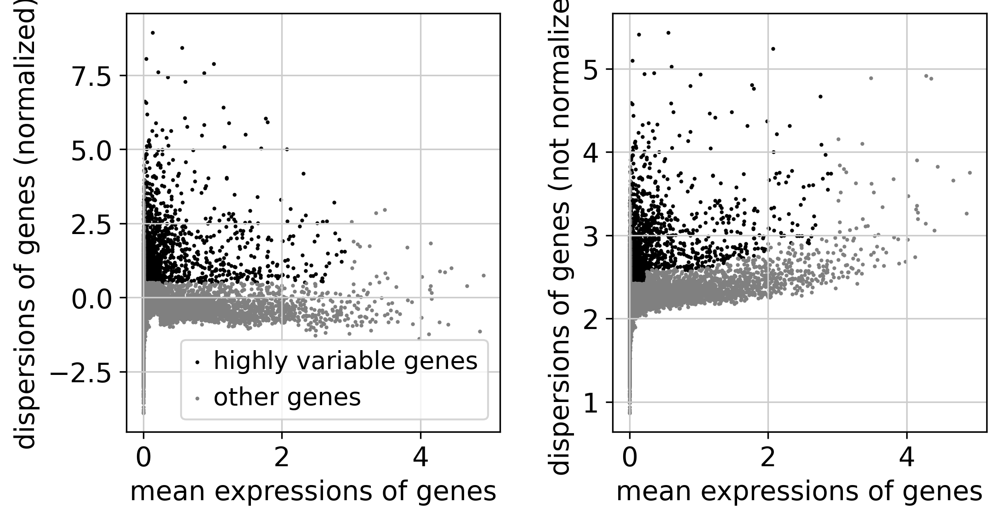

highly_variable
False    14136
True      2083
Name: count, dtype: int64

In [72]:
# HVG
sc.pp.highly_variable_genes(adata_adfca_olf, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_adfca_olf)
adata_adfca_olf.var['highly_variable'].value_counts()

In [73]:
adata_adfca_olf.raw = adata_adfca_olf
adata_adfca_olf = adata_adfca_olf[:, adata_adfca_olf.var.highly_variable]

sc.pp.regress_out(adata_adfca_olf, ['total_counts'])
sc.pp.scale(adata_adfca_olf, max_value=10)

regressing out ['total_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:07)


In [74]:
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 2083
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


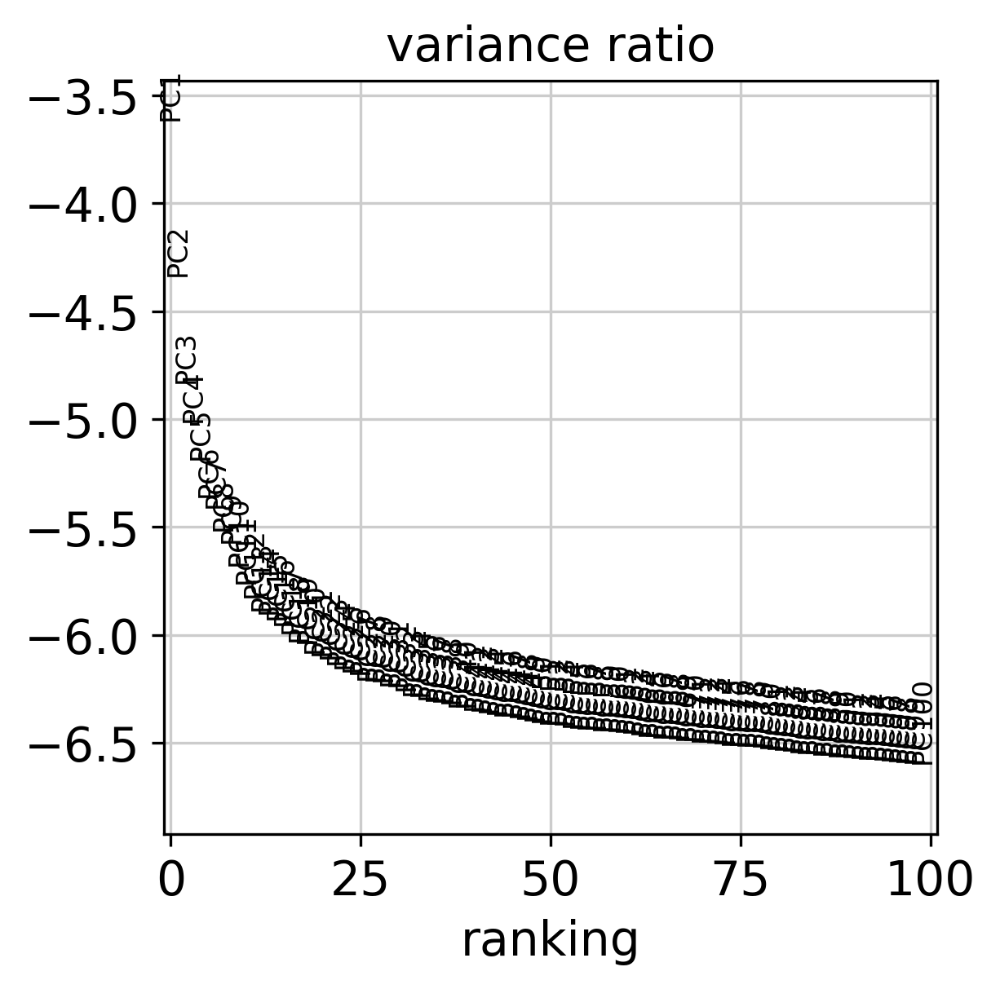

In [75]:
# PCA
sc.tl.pca(adata_adfca_olf, svd_solver='arpack', n_comps=100)
sc.pl.pca_variance_ratio(adata_adfca_olf, log=True, n_pcs=100)

In [76]:
# nn
sc.pp.neighbors(adata_adfca_olf, n_neighbors=10, n_pcs= 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [77]:
sc.tl.tsne(adata_adfca_olf, n_jobs=60, n_pcs=50)
sc.tl.umap(adata_adfca_olf)
sc.tl.leiden(adata_adfca_olf)

computing tSNE
    using 'X_pca' with n_pcs = 50
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)
running Leiden clustering
    finished: found 31 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [78]:
adata_adfca_olf.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron Gr21a, Gr63a' if leiden == '12' else adata_adfca_olf.obs.adfca_annotation_olfactory[n] for n, leiden in enumerate(adata_adfca_olf.obs.leiden)])

In [ ]:
adata_adfca_olf.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron Or43a, Or2a' if annot == 'adult olfactory receptor neuron Or43a/Or2a' else annot  for annot in adata_adfca_olf.obs.adfca_annotation_olfactory ])

In [49]:
adata_adfca_olf.write(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')
adata_adfca_olf.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory_raw.h5ad')

### temp modification

In [46]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')

In [31]:
adata_adfca_olf.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron' if annot == 'olfactory receptor neuron' else annot  for annot in adata_adfca_olf.obs.adfca_annotation_olfactory ])

In [47]:
adata_adfca_olf.obs.adfca_annotation_olfactory = pd.Categorical(['adult olfactory receptor neuron Or43a, Or2a' if annot == 'adult olfactory receptor neuron Or43a/Or2a' else annot  for annot in adata_adfca_olf.obs.adfca_annotation_olfactory ])

In [48]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1276
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
adult olfactory receptor neuron Gr21a, Gr63a                                       149
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Or42b      

### update adfca_annotation_olfactory to v0.4 adata

In [28]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 2083
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [24]:
adata_adfca_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony.h5ad')
adata_adfca_head

AnnData object with n_obs × n_vars = 360036 × 2000
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'adfca_annotation_colors', 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [25]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1276
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
adult olfactory receptor neuron Gr21a, Gr63a                                       149
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Or42b      

In [26]:
olf_annot_D = dict(zip(adata_adfca_olf.obs.index, adata_adfca_olf.obs.adfca_annotation_olfactory))

In [29]:
adata_adfca_head.obs['adfca_annotation_olfactory'] = pd.Categorical([olf_annot_D[obs] if obs in olf_annot_D.keys() else adata_adfca_head.obs['adfca_annotation'][n] for n, obs in enumerate(adata_adfca_head.obs_names)])

In [30]:
adata_adfca_head.write('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad')
adata_adfca_head.raw.to_adata().write('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory_raw.h5ad')

### plot (1) clsuters, (2) dotplot for each ORN

In [31]:
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 2083
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'leiden_1.0', 'leiden_1.5', 'leiden_2.0', 'leiden_3.0', 'leiden_4.0', 'leiden_5.0', 'leiden_6.0', 'leiden_7.0', 'leiden_8.0', 'leiden_9.0', 'leiden_10.0', 'adfca_annotation_group', 'adfca_annotation_group2', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


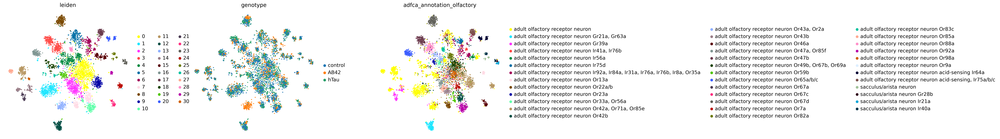

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


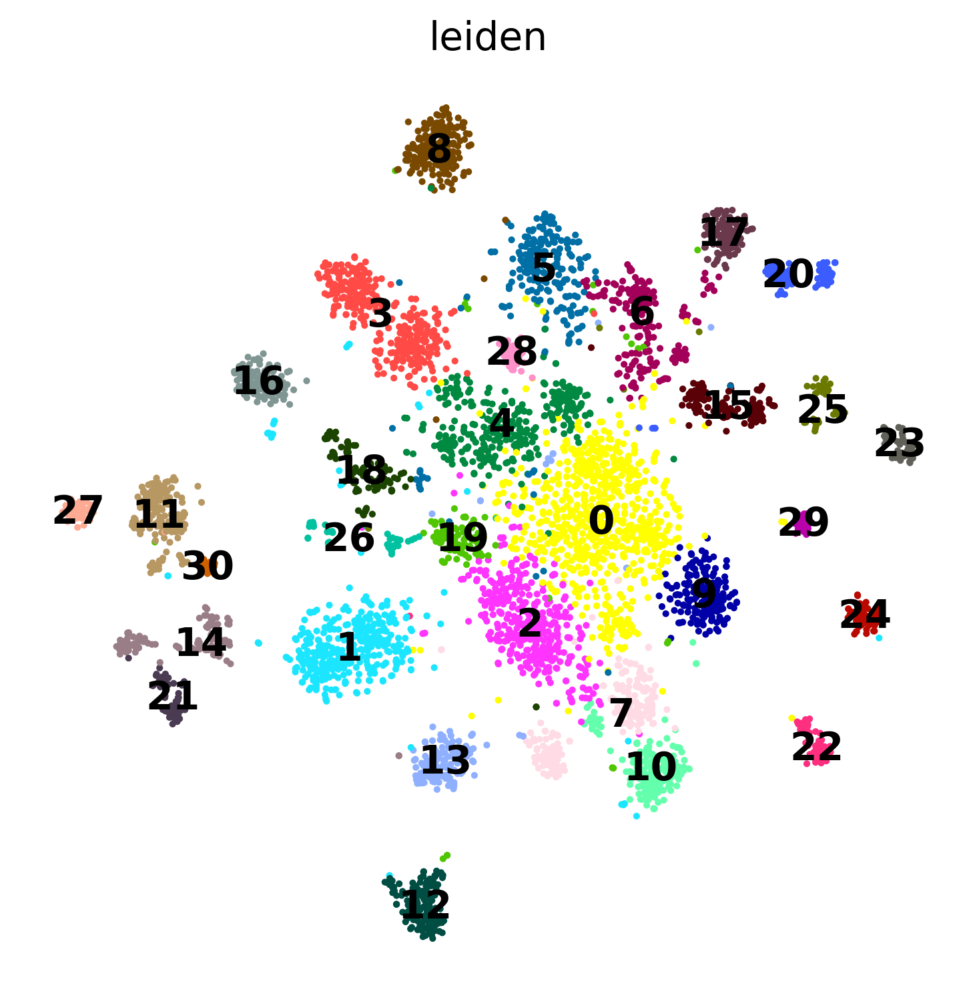

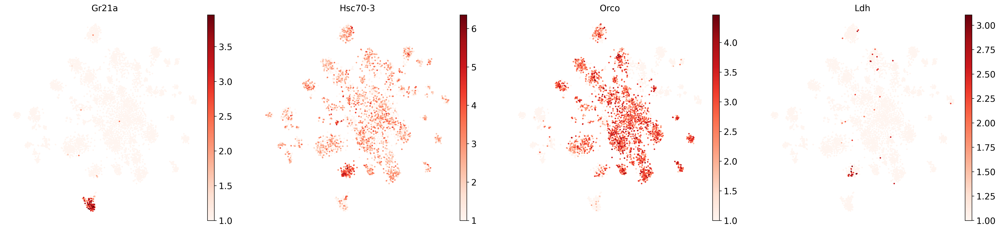

/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


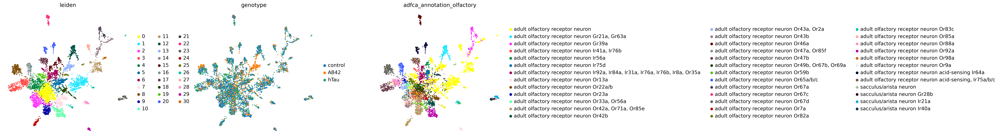

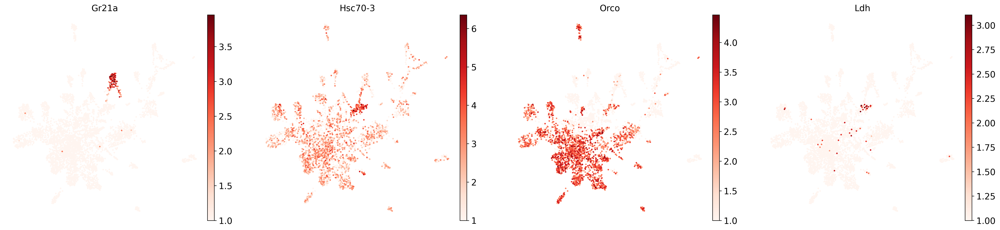

In [32]:
with rc_context({'figure.figsize': (6,6)}):
    sc.pl.tsne(adata_adfca_olf, color=['leiden', 'genotype', 'adfca_annotation_olfactory'], wspace=0.3, frameon=False,)
    sc.pl.tsne(adata_adfca_olf, color=['leiden'], wspace=0.3, frameon=False, legend_loc='on data',) # legend_fontsize=8
    sc.pl.tsne(adata_adfca_olf, color=['Gr21a', 'Hsc70-3', 'Orco', 'Ldh' ], cmap='Reds', vmin=1, frameon=False,) # 'CG43689', 'HnRNP-K',
    
    sc.pl.umap(adata_adfca_olf, color=['leiden', 'genotype', 'adfca_annotation_olfactory'], wspace=0.3, frameon=False,)
    sc.pl.umap(adata_adfca_olf, color=['Gr21a', 'Hsc70-3', 'Orco', 'Ldh' ], cmap='Reds', vmin=1, frameon=False,) # 'CG43689', 'HnRNP-K',

    
    # sc.pl.umap(adata_adfca_olf, color=['genotype', 'adfca_annotation_2nd'], wspace=0.3, frameon=False,)
    # sc.pl.umap(adata_adfca_olf, color=['Gr21a', 'Hsc70-3', 'Orco', 'Ldh' ], cmap='Reds', vmin=1, frameon=False,) # 'CG43689', 'HnRNP-K',

In [33]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1276
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
adult olfactory receptor neuron Gr21a, Gr63a                                       149
adult olfactory receptor neuron Gr39a                                              141
adult olfactory receptor neuron Or42b      

In [70]:
gene_D = {}
for celltype in adata_adfca_olf.obs.adfca_annotation_olfactory.cat.categories:
    if celltype not in ['adult olfactory receptor neuron', 'sacculus/arista neuron']:
        adata = adata_adfca_olf[adata_adfca_olf.obs.adfca_annotation_olfactory == celltype]
        
        if 'adult olfactory receptor neuron' in celltype:
            if 'acid-sensing' not in celltype:
                if '/' not in celltype:
                    gene_L = celltype.split('adult olfactory receptor neuron ')[-1].split(', ')
                    # print(celltype)
                    # print(gene_L)
                else:
                    firstGene = celltype.split('adult olfactory receptor neuron ')[-1].split(', ')[-1].split('/')[0]
                    genePrfix = firstGene[:-1]
                    gene_L = [firstGene] + [genePrfix + suffix for suffix in celltype.split('adult olfactory receptor neuron ')[-1].split(', ')[-1].split('/')[1:] ]
                    # print(celltype)
                    # print(gene_L)
            else:
                if ',' not in celltype: firstGene = celltype.split('adult olfactory receptor neuron acid-sensing ')[-1].split('/')[0]
                else: firstGene = celltype.split('adult olfactory receptor neuron acid-sensing')[-1].split(', ')[-1].split('/')[0]
                    
                genePrfix = firstGene[:-1]
                gene_L = [firstGene] + [genePrfix + suffix for suffix in celltype.split('adult olfactory receptor neuron acid-sensing')[-1].split(', ')[-1].split('/')[1:] ]
                # print(celltype)
                # print(gene_L)
        else:
            gene_L = [celltype.split('sacculus/arista neuron ')[-1]]
            # print(celltype)
            # print(gene_L)
            
        gene_D[celltype] = gene_L
print(gene_D)

{'adult olfactory receptor neuron Gr21a, Gr63a': ['Gr21a', 'Gr63a'], 'adult olfactory receptor neuron Gr39a': ['Gr39a'], 'adult olfactory receptor neuron Ir41a, Ir76b': ['Ir41a', 'Ir76b'], 'adult olfactory receptor neuron Ir56a': ['Ir56a'], 'adult olfactory receptor neuron Ir75d': ['Ir75d'], 'adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a': ['Ir92a', 'Ir84a', 'Ir31a', 'Ir76a', 'Ir76b', 'Ir8a', 'Or35a'], 'adult olfactory receptor neuron Or13a': ['Or13a'], 'adult olfactory receptor neuron Or22a/b': ['Or22a', 'Or22b'], 'adult olfactory receptor neuron Or23a': ['Or23a'], 'adult olfactory receptor neuron Or33a, Or56a': ['Or33a', 'Or56a'], 'adult olfactory receptor neuron Or42a, Or71a, Or85e': ['Or42a', 'Or71a', 'Or85e'], 'adult olfactory receptor neuron Or42b': ['Or42b'], 'adult olfactory receptor neuron Or43a, Or2a': ['Or43a', 'Or2a'], 'adult olfactory receptor neuron Or43b': ['Or43b'], 'adult olfactory receptor neuron Or46a': ['Or46a'], 'adult olfactory rec

In [73]:
coreceptor_L = ['Orco', 'Ir25a', 'Ir76b', 'Ir8a']
for celltype in list(gene_D.keys())[:]:
    print(celltype)
    celltypeName = '_'.join(celltype.split('/'))
    adata = adata_adfca_olf[adata_adfca_olf.obs.adfca_annotation_olfactory == celltype]
    sc.pl.dotplot(adata, var_names=gene_D[celltype]+coreceptor_L, groupby='genotype', title=f'{celltype}_nuclei#:{len(adata)}', 
                  show=False, save=f'_{celltypeName}.pdf') # 'CG43689', 

adult olfactory receptor neuron Gr21a, Gr63a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Gr39a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir41a, Ir76b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir56a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir75d


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or13a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or22a/b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or23a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or33a, Or56a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or42a, Or71a, Or85e


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or42b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or43a, Or2a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or43b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or46a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or47a, Or85f


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or47b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or49b, Or67b, Or69a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or59b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or65a/b/c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67d


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or7a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or82a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or83c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or85a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or88a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or92a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or98a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or9a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron acid-sensing Ir64a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron acid-sensing, Ir75a/b/c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Gr28b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Ir21a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Ir40a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


In [74]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{olfAnnotPicFolder}/{x}')

# Merge ORN and OPN

## Merge data

In [33]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad').raw.to_adata()
# adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.3/adfca_head_v0.3_woHarmony.h5ad').raw.to_adata()
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad').raw.to_adata()

In [34]:
adata_OPN = adata_head[adata_head.obs.adfca_annotation == 'olfactory projection neuron']
adata_OPN.obs = adata_OPN.obs.loc[:, ['n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 
                                       'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad']]
adata_OPN

AnnData object with n_obs × n_vars = 736 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [35]:
adata_adfca_olf.obs = adata_adfca_olf.obs.loc[:, ['n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 
                                                   'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory']]
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [36]:
adata_adfca_orn_opn = adata_adfca_olf.concatenate(adata_OPN, join='outer')
adata_adfca_orn_opn

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


AnnData object with n_obs × n_vars = 5788 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

## Identify DEGs between ORN & OPN

In [37]:
csvFile=f'{olfAnnotFolder}/DEG_ORN_vs_OPN.csv'

sc.tl.rank_genes_groups(adata_adfca_orn_opn, groupby='adfca_annotation', reference='olfactory projection neuron', method='wilcoxon')

result = adata_adfca_orn_opn.uns['rank_genes_groups']
groups = result['names'].dtype.names
degDf =pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals', 'pvals_adj', 'logfoldchanges']})

degDf.to_csv(csvFile, index=False)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


In [38]:
degDf

,olfactory receptor neuron_names,olfactory receptor neuron_pvals,olfactory receptor neuron_pvals_adj,olfactory receptor neuron_logfoldchanges
0,HnRNP-K,0.000000e+00,0.000000e+00,5.316688
1,cpo,2.580899e-300,4.185960e-297,1.769071
2,Ank2,4.215024e-288,5.258728e-285,1.901581
3,pHCl-1,1.586427e-268,1.354224e-265,2.171852
4,CG32137,1.542125e-263,1.191034e-260,5.383328
...,...,...,...,...
16214,mmd,0.000000e+00,0.000000e+00,-5.235174
16215,nAChRalpha6,0.000000e+00,0.000000e+00,-6.746960
16216,nAChRalpha5,0.000000e+00,0.000000e+00,-5.980382
16217,CG17684,0.000000e+00,0.000000e+00,-3.896233


In [39]:
ornHigh_L = degDf['olfactory receptor neuron_names'].to_list()[:100]
len(ornHigh_L)

100

In [40]:
OutFile1 = open(f'{olfAnnotFolder}/ornHigh_L.list', 'w')
for gene in ornHigh_L: OutFile1.write(gene+'\n')
OutFile1.close()

## HVG to tsne

In [41]:
adata_adfca_orn_opn

AnnData object with n_obs × n_vars = 5788 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    uns: 'rank_genes_groups'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


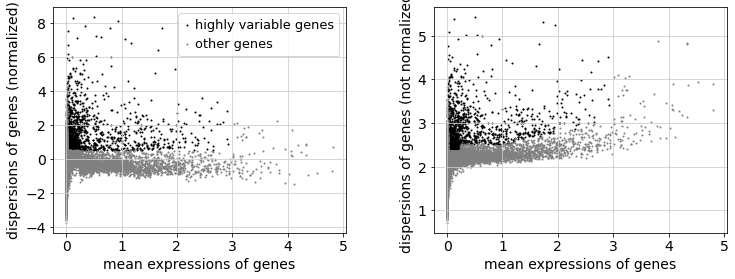

highly_variable
False    14148
True      2071
Name: count, dtype: int64

In [42]:
# HVG
sc.pp.highly_variable_genes(adata_adfca_orn_opn, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_adfca_orn_opn)
adata_adfca_orn_opn.var['highly_variable'].value_counts()

In [43]:
adata_adfca_orn_opn.var.highly_variable = [True if var in ornHigh_L else adata_adfca_orn_opn.var.highly_variable[n] for n, var in enumerate(adata_adfca_orn_opn.var_names) ]
adata_adfca_orn_opn.var['highly_variable'].value_counts()

highly_variable
False    14067
True      2152
Name: count, dtype: int64

In [44]:
adata_adfca_orn_opn.raw = adata_adfca_orn_opn
adata_adfca_orn_opn = adata_adfca_orn_opn[:, adata_adfca_orn_opn.var.highly_variable]

sc.pp.regress_out(adata_adfca_orn_opn, ['total_counts'])
sc.pp.scale(adata_adfca_orn_opn, max_value=10)

regressing out ['total_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:08)


In [45]:
adata_adfca_orn_opn

AnnData object with n_obs × n_vars = 5788 × 2152
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'rank_genes_groups', 'hvg'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


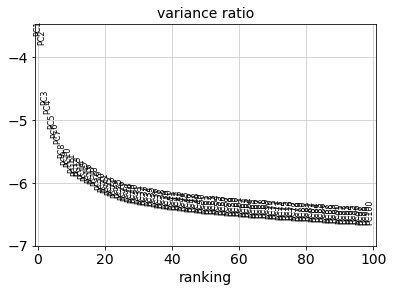

In [60]:
# PCA
sc.tl.pca(adata_adfca_orn_opn, svd_solver='arpack', n_comps=100)
sc.pl.pca_variance_ratio(adata_adfca_orn_opn, log=True, n_pcs=100)

In [67]:
# nn
sc.pp.neighbors(adata_adfca_orn_opn, n_neighbors=15, n_pcs= 10)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [68]:
sc.tl.tsne(adata_adfca_orn_opn, n_jobs=60, n_pcs=10)
sc.tl.umap(adata_adfca_orn_opn)
sc.tl.leiden(adata_adfca_orn_opn)

computing tSNE
    using 'X_pca' with n_pcs = 10
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:09)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [54]:
# adata_adfca_orn_opn.obs.adfca_annotation_2nd = ['olfactory projection neuron' if annot == 'olfactory projection neuron' else adata_adfca_orn_opn.obs.adfca_annotation_2nd[n] for n, annot in enumerate(adata_adfca_orn_opn.obs.adfca_annotation)]
# adata_adfca_orn_opn.obs.adfca_annotation_2nd = ['adult olfactory receptor neuron unknown type' if annot in ['olfactory receptor neuron', 'unannotated'] else annot for n, annot in enumerate(adata_adfca_orn_opn.obs.adfca_annotation_2nd)]

In [69]:
adata_adfca_orn_opn.write(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne.h5ad')
adata_adfca_orn_opn.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne_raw.h5ad')

### plot

In [70]:
adata_adfca_orn_opn=sc.read(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


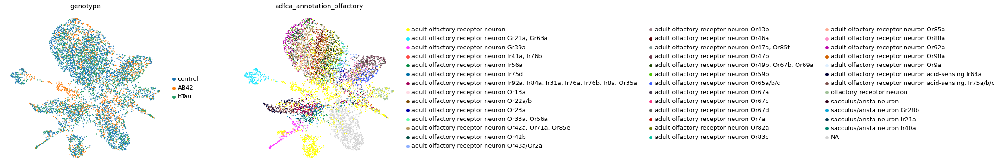

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


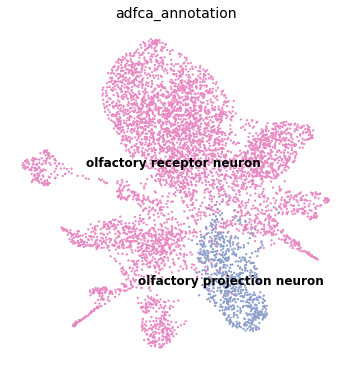

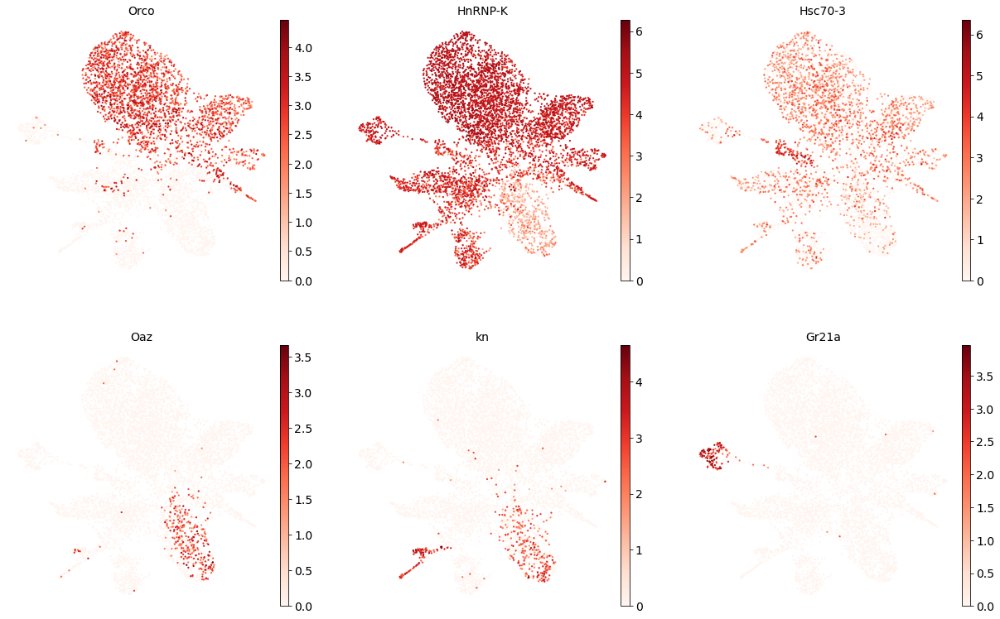

In [72]:
with rc_context({'figure.figsize': (6,6)}):
    sc.pl.umap(adata_adfca_orn_opn, color=['genotype', 'adfca_annotation_olfactory'], wspace=0.3, frameon=False, save=f'_adata_adfca_orn_opn_genotype_adfca_annotation_olfactory.pdf')
    sc.pl.umap(adata_adfca_orn_opn, color=['adfca_annotation'], wspace=0.3, frameon=False, save=f'_adata_adfca_orn_opn_adfca_annotation.pdf', palette=sns.color_palette("Set2")[2:4], 
               legend_loc='on data',legend_fontsize=12)
    sc.pl.umap(adata_adfca_orn_opn, color=['Orco', 'HnRNP-K', 'Hsc70-3', 'Oaz', 'kn', 'Gr21a'], cmap='Reds', frameon=False, save=f'_adata_adfca_orn_opn_markerGenes.pdf', ncols=3) # 'CG43689', 'HnRNP-K', # vmin=1, 

In [73]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{olfAnnotPicFolder}/{x}')

## HVG to tsne (without tau)

### merge data

In [74]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad').raw.to_adata()
# adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.3/adfca_head_v0.3_woHarmony.h5ad').raw.to_adata()
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad').raw.to_adata()

In [75]:
adata_OPN = adata_head[adata_head.obs.adfca_annotation == 'olfactory projection neuron']
adata_OPN.obs = adata_OPN.obs.loc[:, ['n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 
                                       'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad']]
adata_OPN

AnnData object with n_obs × n_vars = 736 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [76]:
adata_adfca_olf.obs = adata_adfca_olf.obs.loc[:, ['n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 
                                                   'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory']]
adata_adfca_olf

AnnData object with n_obs × n_vars = 5052 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'hvg', 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'
    obsp: 'connectivities', 'distances'

In [77]:
adata_adfca_orn_opn = adata_adfca_olf.concatenate(adata_OPN, join='outer')
adata_adfca_orn_opn = adata_adfca_orn_opn[adata_adfca_orn_opn.obs.genotype != 'hTau']
adata_adfca_orn_opn

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


View of AnnData object with n_obs × n_vars = 3853 × 16219
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

### HVG to tsne

In [78]:
ornHigh_L = [gene.strip() for gene in open(f'{olfAnnotFolder}/ornHigh_L.list')]

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:540: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


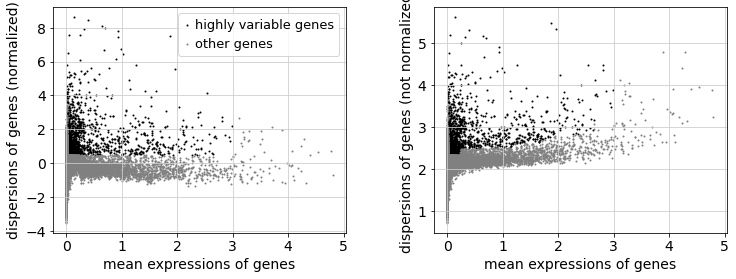

highly_variable
False    14142
True      2077
Name: count, dtype: int64

In [79]:
# HVG
sc.pp.highly_variable_genes(adata_adfca_orn_opn, min_mean=0.01, max_mean=3, min_disp=0.5)
sc.pl.highly_variable_genes(adata_adfca_orn_opn)
adata_adfca_orn_opn.var['highly_variable'].value_counts()

In [80]:
adata_adfca_orn_opn.var.highly_variable = [True if var in ornHigh_L else adata_adfca_orn_opn.var.highly_variable[n] for n, var in enumerate(adata_adfca_orn_opn.var_names) ]
adata_adfca_orn_opn.var['highly_variable'].value_counts()

highly_variable
False    14060
True      2159
Name: count, dtype: int64

In [81]:
adata_adfca_orn_opn.raw = adata_adfca_orn_opn
adata_adfca_orn_opn = adata_adfca_orn_opn[:, adata_adfca_orn_opn.var.highly_variable]

sc.pp.regress_out(adata_adfca_orn_opn, ['total_counts'])
sc.pp.scale(adata_adfca_orn_opn, max_value=10)

regressing out ['total_counts']
    sparse input is densified and may lead to high memory use
    finished (0:00:04)


In [82]:
adata_adfca_orn_opn

AnnData object with n_obs × n_vars = 3853 × 2159
    obs: 'n_genes', 'dataset', 'cellBC', 'sex', 'tissue', 'age', 'genotype', 'sex_age', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'genoAge', 'genoAgeSex', 'adfca_annotation', 'adfca_annotation_broad', 'adfca_annotation_olfactory'
    var: 'gene_ids', 'highly_variable-0', 'means-0', 'dispersions-0', 'dispersions_norm-0', 'highly_variable-1', 'means-1', 'dispersions-1', 'dispersions_norm-1', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'latent_gene_encoding'

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:00)


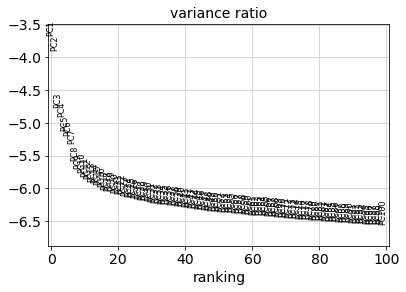

In [83]:
# PCA
sc.tl.pca(adata_adfca_orn_opn, svd_solver='arpack', n_comps=100)
sc.pl.pca_variance_ratio(adata_adfca_orn_opn, log=True, n_pcs=100)

In [84]:
# nn
sc.pp.neighbors(adata_adfca_orn_opn, n_neighbors=15, n_pcs= 20)

computing neighbors
    using 'X_pca' with n_pcs = 20
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [85]:
sc.tl.tsne(adata_adfca_orn_opn, n_jobs=60, n_pcs=20)
sc.tl.umap(adata_adfca_orn_opn)
sc.tl.leiden(adata_adfca_orn_opn)

computing tSNE
    using 'X_pca' with n_pcs = 20
    using sklearn.manifold.TSNE


/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/tools/_tsne.py:113: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  warnings.warn(


    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
running Leiden clustering
    finished: found 23 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


In [47]:
# adata_adfca_orn_opn.obs.adfca_annotation_2nd = ['olfactory projection neuron' if annot == 'olfactory projection neuron' else adata_adfca_orn_opn.obs.adfca_annotation_2nd[n] for n, annot in enumerate(adata_adfca_orn_opn.obs.adfca_annotation)]
# adata_adfca_orn_opn.obs.adfca_annotation_2nd = ['adult olfactory receptor neuron unknown type' if annot in ['olfactory receptor neuron', 'unannotated'] else annot for n, annot in enumerate(adata_adfca_orn_opn.obs.adfca_annotation_2nd)]

In [86]:
adata_adfca_orn_opn.write(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne_noTau.h5ad')
adata_adfca_orn_opn.raw.to_adata().write(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne_noTau_raw.h5ad')

### plot

In [87]:
adata_adfca_orn_opn=sc.read(f'{olfAnnotFolder}/olfactory_8.adata_adfca_orn_opn_hvg_tsne_noTau.h5ad')

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


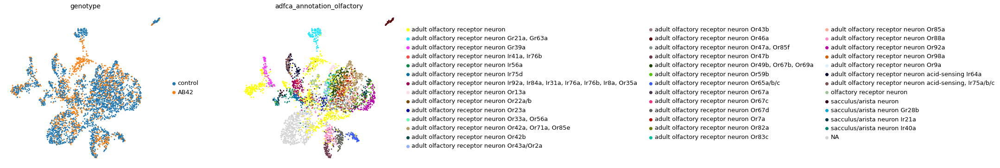

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


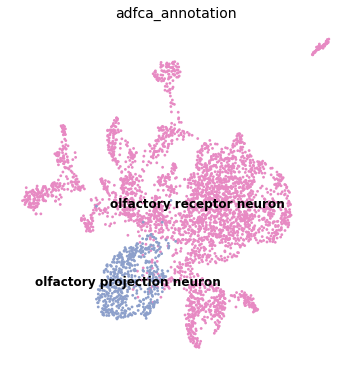

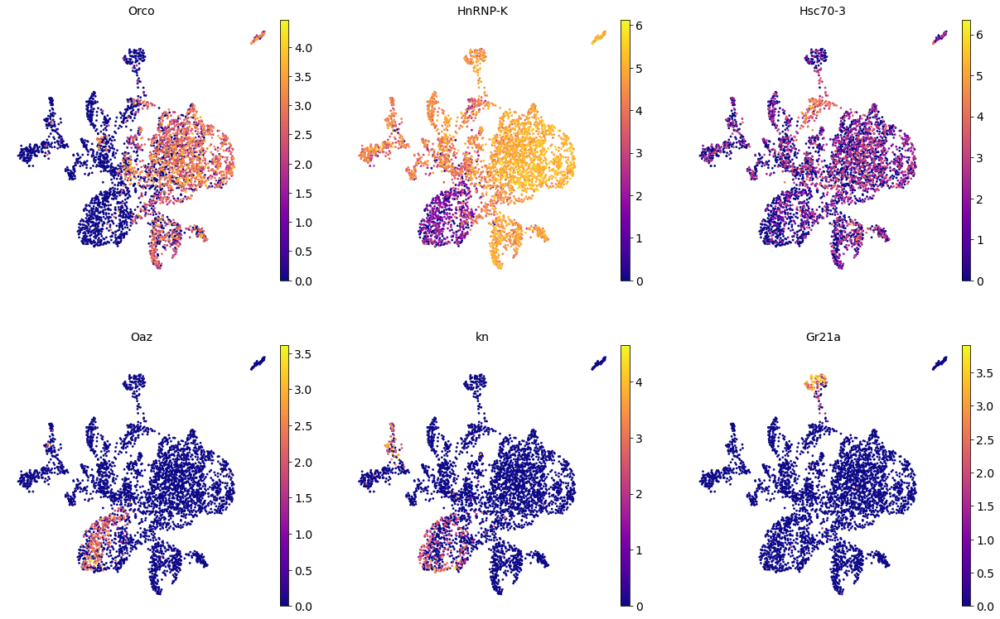

In [89]:
with rc_context({'figure.figsize': (6,6)}):
    sc.pl.umap(adata_adfca_orn_opn, color=['genotype', 'adfca_annotation_olfactory'], wspace=0.3, frameon=False, save=f'_adata_adfca_orn_opn_genotype_adfca_annotation_olfactory_noTau.pdf')
    sc.pl.umap(adata_adfca_orn_opn, color=['adfca_annotation'], wspace=0.3, frameon=False, save=f'_adata_adfca_orn_opn_adfca_annotation_noTau.pdf', palette=sns.color_palette("Set2")[2:4], 
               legend_loc='on data',legend_fontsize=12)
    sc.pl.umap(adata_adfca_orn_opn, color=['Orco', 'HnRNP-K', 'Hsc70-3', 'Oaz', 'kn', 'Gr21a'], cmap='plasma', frameon=False, save=f'_adata_adfca_orn_opn_markerGenes_noTau.pdf', ncols=3) # 'CG43689', 'HnRNP-K',

In [90]:
for x in os.listdir('figures/'): 
    os.replace(f'figures/{x}', f'{olfAnnotPicFolder}/{x}')

# Combine ORN detailed annotations

## Modify annotation

In [91]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad')

In [92]:
annot2_D = dict(zip(adata_adfca_olf.obs.index, adata_adfca_olf.obs.adfca_annotation_olfactory))

In [93]:
annot2_D

{'CCTCCAAGTATGAGCG-1_11_D20CEFH': 'adult olfactory receptor neuron Gr39a',
 'ACGTACACACCAGCGT-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'CACTGAATCTGAGCAT-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'TCCTAATTCTGACCCT-1_11_D20CEFH': 'adult olfactory receptor neuron Or59b',
 'ATATCCTAGGGAGATA-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'ACCAACAGTCAGGAGT-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'CACTTCGTCATCACTT-1_11_D20CEFH': 'adult olfactory receptor neuron Or42b',
 'GAGGCCTAGAGGTCGT-1_11_D20CEFH': 'adult olfactory receptor neuron Gr39a',
 'CTCACTGGTGTGCTTA-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'TTCATTGCAGACTGCC-1_11_D20CEFH': 'adult olfactory receptor neuron Or42b',
 'AACCTGAGTGCAACGA-1_11_D20CEFH': 'adult olfactory receptor neuron Or42b',
 'ACGTAACCAACAAGTA-1_11_D20CEFH': 'adult olfactory receptor neuron',
 'ATATCCTCAGGTGACA-1_11_D20CEFH': 'adult olfactory receptor neuron acid-sensing, Ir75a/b/c',
 'ACATTTCGTGAATGAT-1_11_D20CEFH': 'adult ol

In [96]:
adata_head.obs['adfca_annotation_olfactory'].value_counts()

adfca_annotation_olfactory
uncharacterized CNS neuron                      97080
unannotated                                     28928
outer photoreceptor cell                        26996
cone cell                                       24409
epithelial cell_head                            21390
                                                ...  
sacculus/arista neuron Ir21a                       34
sacculus/arista neuron                             34
adult olfactory receptor neuron Ir41a, Ir76b       29
lobula columnar neuron LC12                        25
sacculus/arista neuron Gr28b                       11
Name: count, Length: 130, dtype: int64

## Summarize cell# (Separated by genotype)

In [19]:
# adata_head = sc.read(f'{olfAnnotFolder}/adfca_head_v0.3_woHarmony_ornAnnotation.h5ad')
# adata_body = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.3/adfca_body_v0.3_woHarmony.h5ad')

In [20]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad')

In [21]:
adata_head.obs

,latent_RT_efficiency,latent_cell_probability,latent_scale,n_genes,dataset,cellBC,sex,tissue,age,genotype,...,leiden_4.0,leiden_5.0,leiden_6.0,leiden_7.0,leiden_8.0,leiden_9.0,leiden_10.0,adfca_annotation_group,adfca_annotation_group2,adfca_annotation_olfactory
TTCGCTGTCCCAAGCG-1_11_D20CEFH,1.632454,0.999480,1554.837524,1033,11_D20CEFH,TTCGCTGTCCCAAGCG-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
CTCAATTAGACCACGA-1_11_D20CEFH,1.660071,0.999592,1568.089233,1043,11_D20CEFH,CTCAATTAGACCACGA-1,female,head,20,control,...,100,110,115,94,106,124,94,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
GCTACCTTCACCCTCA-1_11_D20CEFH,1.954348,0.999656,1626.214355,1034,11_D20CEFH,GCTACCTTCACCCTCA-1,female,head,20,control,...,7,4,3,3,2,5,141,muscle cell ungrouped,skeletal muscle of head,skeletal muscle of head
AGGGTGAGTGCCGTTG-1_11_D20CEFH,1.628265,0.999738,1579.643555,1150,11_D20CEFH,AGGGTGAGTGCCGTTG-1,female,head,20,control,...,13,210,227,245,267,287,301,hemocyte,hemocyte,hemocyte_head
ATTGTTCTCAGTCATG-1_11_D20CEFH,1.493281,0.999731,1566.443604,972,11_D20CEFH,ATTGTTCTCAGTCATG-1,female,head,20,control,...,3,2,2,1,15,24,14,photoreceptor cell,photoreceptor cell,outer photoreceptor cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CAACGGCGTCGTGGAA-1_9_D20CEMH,0.542235,0.996761,1592.519409,324,9_D20CEMH,CAACGGCGTCGTGGAA-1,male,head,20,control,...,51,55,52,53,49,47,41,lamina neuron,lamina neuron,lamina monopolar neuron L1
CGTTCTGAGTTTGTCG-1_9_D20CEMH,0.542307,0.995080,1609.327393,402,9_D20CEMH,CGTTCTGAGTTTGTCG-1,male,head,20,control,...,70,70,69,67,66,67,63,sensory neuron ungrouped,olfactory receptor neuron,olfactory receptor neuron
CTATAGGCACATTGTG-1_9_D20CEMH,0.543580,0.993411,1608.768188,370,9_D20CEMH,CTATAGGCACATTGTG-1,male,head,20,control,...,156,163,94,98,97,216,153,glial cell ungrouped,subperineurial glial cell,subperineurial glial cell_head
CGAGTTAAGAGGCTGT-1_9_D20CEMH,0.535387,0.991753,1576.863525,361,9_D20CEMH,CGAGTTAAGAGGCTGT-1,male,head,20,control,...,5,3,4,5,4,3,5,CNS neuron ungrouped,uncharacterized CNS neuron,uncharacterized CNS neuron


In [ ]:
# adata_headBody = adata_head.concatenate(adata_body, join='outer')
# adata_headBody.obs.index = [obs[:-2] for obs in adata_headBody.obs_names]
# adata_headBody.obs

/data/tcl/miniconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


,latent_RT_efficiency,latent_cell_probability,latent_scale,n_genes,dataset,cellBC,sex,tissue,age,genotype,...,leiden_2.0,leiden_3.0,leiden_4.0,leiden_5.0,leiden_6.0,leiden_7.0,leiden_8.0,leiden_9.0,leiden_10.0,adfca_annotation_2nd
TTCGCTGTCCCAAGCG-1_11_D20CEFH,1.632454,0.999480,1554.837524,1033,11_D20CEFH,TTCGCTGTCCCAAGCG-1,female,head,20,control,...,80,104,100,110,115,94,106,124,94,outer photoreceptor cell
CTCAATTAGACCACGA-1_11_D20CEFH,1.660071,0.999592,1568.089233,1043,11_D20CEFH,CTCAATTAGACCACGA-1,female,head,20,control,...,80,104,100,110,115,94,106,124,94,outer photoreceptor cell
GCTACCTTCACCCTCA-1_11_D20CEFH,1.954348,0.999656,1626.214355,1034,11_D20CEFH,GCTACCTTCACCCTCA-1,female,head,20,control,...,9,8,7,4,3,3,2,5,141,skeletal muscle of head
AGGGTGAGTGCCGTTG-1_11_D20CEFH,1.628265,0.999738,1579.643555,1150,11_D20CEFH,AGGGTGAGTGCCGTTG-1,female,head,20,control,...,17,16,13,210,227,245,267,287,301,hemocyte_head
ATTGTTCTCAGTCATG-1_11_D20CEFH,1.493281,0.999731,1566.443604,972,11_D20CEFH,ATTGTTCTCAGTCATG-1,female,head,20,control,...,1,0,3,2,2,1,15,24,14,outer photoreceptor cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GAGTTGTCACATTCGA-1_8_D10ABFB,0.477179,0.998440,1892.367065,321,8_D10ABFB,GAGTTGTCACATTCGA-1,female,body,10,AB42,...,5,3,2,19,15,12,10,14,9,NaN
GAAGCGACAGTTACCA-1_8_D10ABFB,0.557848,0.997484,1925.888672,342,8_D10ABFB,GAAGCGACAGTTACCA-1,female,body,10,AB42,...,19,23,24,23,23,21,21,23,21,NaN
AGCGTCGTCCATGATG-1_8_D10ABFB,0.445145,0.998755,1886.357910,254,8_D10ABFB,AGCGTCGTCCATGATG-1,female,body,10,AB42,...,70,81,95,110,123,132,139,153,163,NaN
CACAGGCGTCTGTGTA-1_8_D10ABFB,0.715374,0.988256,1943.386597,326,8_D10ABFB,CACAGGCGTCTGTGTA-1,female,body,10,AB42,...,64,64,48,55,111,88,91,98,106,NaN


In [ ]:
# adata_headBody.obs.adfca_annotation_2nd.isna()

TTCGCTGTCCCAAGCG-1_11_D20CEFH    False
CTCAATTAGACCACGA-1_11_D20CEFH    False
GCTACCTTCACCCTCA-1_11_D20CEFH    False
AGGGTGAGTGCCGTTG-1_11_D20CEFH    False
ATTGTTCTCAGTCATG-1_11_D20CEFH    False
                                 ...  
GAGTTGTCACATTCGA-1_8_D10ABFB      True
GAAGCGACAGTTACCA-1_8_D10ABFB      True
AGCGTCGTCCATGATG-1_8_D10ABFB      True
CACAGGCGTCTGTGTA-1_8_D10ABFB      True
AGCGTCGGTGGCCTCA-1_8_D10ABFB      True
Name: adfca_annotation_2nd, Length: 624458, dtype: bool

In [ ]:
# adata_headBody.obs['adfca_annotation_2nd'] = [adata_headBody.obs.adfca_annotation_2nd[n] if obs in adata_head.obs.index else adata_headBody.obs.adfca_annotation[n] for n, obs in enumerate(adata_headBody.obs_names)]

In [ ]:
# adata_headBody.obs['adfca_annotation_2nd'].value_counts()

adfca_annotation_2nd
uncharacterized CNS neuron                               97080
follicle cell                                            39540
unannotated                                              37815
adult fat body_body                                      36353
outer photoreceptor cell                                 26996
                                                         ...  
adult olfactory receptor neuron Or67c                       38
adult heart ventral longitudinal muscle                     34
cardiomyocyte, working adult heart muscle (non-ostia)       25
lobula columnar neuron LC12                                 25
young germ cell                                             22
Name: count, Length: 191, dtype: int64

In [22]:
genoCompare_Df

,expSet,controlSet,age
0,AB42,control_inAB42,"10,20"
1,hTau,control_inTau,"20,30"


In [23]:
celltypeGeno_Df=adata_head.obs.groupby(by=['adfca_annotation_olfactory', 'genotype']).agg({'sex': 'count'})
celltypeGeno_Df

sex
adfca_annotation_olfactory genotype       
ABeta42-specific cluster   control     696
                           AB42       2799
                           hTau        413
Johnston organ neuron      control    1165
                           AB42        647
...                                    ...
unannotated                AB42       8773
                           hTau       7228
uncharacterized CNS neuron control   44875
                           AB42      21753
                           hTau      30452

[390 rows x 1 columns]

In [24]:
celltypeN_Df=pd.DataFrame(columns=['annotation', 'cellN' ]+['cellN_' + genotype for genotype in genotype_L ])

In [25]:
celltypeN_Df=pd.DataFrame(columns=['annotation', 'cellN' ]+['cellN_' + genotype for genotype in genotype_L ])
for celltype in sorted( set(celltypeGeno_Df.index.get_level_values('adfca_annotation_olfactory')) ):
    # print(celltype)
    
    celltypeCount_Df=celltypeGeno_Df.loc[celltype]
    cellN=celltypeCount_Df.sex.sum()
    # print(cellN)
    
    lowNumAge='N'

    if lowNumAge == 'N':
        celltypeN_Df.loc[celltype]=[celltype, cellN] + celltypeCount_Df.sex.to_list()
    # print()

In [26]:
celltypeN_Df

,annotation,cellN,cellN_control,cellN_AB42,cellN_hTau
ABeta42-specific cluster,ABeta42-specific cluster,3908,696,2799,413
Johnston organ neuron,Johnston organ neuron,2587,1165,647,775
Poxn neuron,Poxn neuron,681,317,124,240
T neuron T2,T neuron T2,1371,621,337,413
T neuron T2a,T neuron T2a,2060,865,610,585
...,...,...,...,...,...
transmedullary neuron Tm4,transmedullary neuron Tm4,1311,552,361,398
transmedullary neuron Tm5c,transmedullary neuron Tm5c,408,169,140,99
transmedullary neuron Tm9,transmedullary neuron Tm9,1065,434,342,289
unannotated,unannotated,28928,12927,8773,7228


In [27]:
celltypeN700_Df = celltypeN_Df[ (celltypeN_Df.cellN >= 700) & (~celltypeN_Df.annotation.isin(['unannotated', 'uncharacterized CNS neuron'])) ]

In [28]:
celltypeN700_Df

,annotation,cellN,cellN_control,cellN_AB42,cellN_hTau
ABeta42-specific cluster,ABeta42-specific cluster,3908,696,2799,413
Johnston organ neuron,Johnston organ neuron,2587,1165,647,775
T neuron T2,T neuron T2,1371,621,337,413
T neuron T2a,T neuron T2a,2060,865,610,585
T neuron T3,T neuron T3,1620,711,507,402
...,...,...,...,...,...
transmedullary neuron Tm2,transmedullary neuron Tm2,1863,822,484,557
transmedullary neuron Tm20,transmedullary neuron Tm20,1052,467,313,272
transmedullary neuron Tm3a,transmedullary neuron Tm3a,2270,1060,502,708
transmedullary neuron Tm4,transmedullary neuron Tm4,1311,552,361,398


In [29]:
# at lease 100*7 cells # 7 exp sets
celltypeN_Df.to_csv(f'{cellnFolder}/celltype_cellN.csv', index=False)
celltypeN700_Df.to_csv(f'{cellnFolder}/celltype_cellN_n700.csv', index=False)

In [30]:
# expCompare_Df.to_csv(f'{cellnFolder}/expCompare_Df.csv', index=False)
# ageCompare_Df.to_csv(f'{cellnFolder}/ageCompare_Df.csv', index=False)

## Head

In [31]:
adfcaTissue='head'

In [32]:
celltypeN700_L = pd.read_csv(f'{cellnFolder}/celltype_cellN_n700.csv').annotation.to_list()

In [33]:
annotationDf=pd.DataFrame(adata_head.obs['adfca_annotation_olfactory'].value_counts())
annotationDf.columns = ['TotalCellN']

for genoAge in genoAge_L:
    # print(genoAge)
    annotationDf[f'{genoAge}_CellN'] = adata_head[adata_head.obs.genoAge == genoAge].obs['adfca_annotation_olfactory'].value_counts()

annotationDf.fillna(0, inplace=True)
annotationDf

,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
uncharacterized CNS neuron,97080,14445,16071,14359.0,11673,10080,17060,13392
unannotated,28928,5212,4731,2984.0,4659,4114,4124,3104
outer photoreceptor cell,26996,3879,5563,3864.0,3225,3111,3341,4013
cone cell,24409,3206,4572,3421.0,2844,3013,4431,2922
epithelial cell_head,21390,3208,3142,2696.0,3076,2879,3504,2885
...,...,...,...,...,...,...,...,...
sacculus/arista neuron Ir21a,34,3,6,7.0,3,1,9,5
sacculus/arista neuron,34,2,5,7.0,3,2,10,5
"adult olfactory receptor neuron Ir41a, Ir76b",29,3,7,2.0,3,6,5,3
lobula columnar neuron LC12,25,4,5,3.0,2,3,7,1


In [34]:
'adult olfactory receptor neuron Gr21a, Gr63a' in annotationDf.index

True

In [35]:
annotationDf.to_csv(f'{cellnFolder}/{adfcaTissue}_cellN.csv')

## Ratio (separated by genotype)

In [36]:
annotationDf=pd.read_csv(f'{cellnFolder}/{adfcaTissue}_cellN.csv', index_col=0)

In [37]:
annotationDf

,TotalCellN,control_10_CellN,control_20_CellN,control_30_CellN,AB42_10_CellN,AB42_20_CellN,hTau_20_CellN,hTau_30_CellN
uncharacterized CNS neuron,97080,14445,16071,14359.0,11673,10080,17060,13392
unannotated,28928,5212,4731,2984.0,4659,4114,4124,3104
outer photoreceptor cell,26996,3879,5563,3864.0,3225,3111,3341,4013
cone cell,24409,3206,4572,3421.0,2844,3013,4431,2922
epithelial cell_head,21390,3208,3142,2696.0,3076,2879,3504,2885
...,...,...,...,...,...,...,...,...
sacculus/arista neuron Ir21a,34,3,6,7.0,3,1,9,5
sacculus/arista neuron,34,2,5,7.0,3,2,10,5
"adult olfactory receptor neuron Ir41a, Ir76b",29,3,7,2.0,3,6,5,3
lobula columnar neuron LC12,25,4,5,3.0,2,3,7,1


In [38]:
annotationGeno_Df=annotationDf.iloc[:,:1]
annotationGeno_Df['control_inAB42'] = annotationDf['control_10_CellN'] + annotationDf['control_20_CellN']
annotationGeno_Df['AB42'] = annotationDf['AB42_10_CellN'] + annotationDf['AB42_20_CellN']
annotationGeno_Df['control_inTau'] = annotationDf['control_20_CellN'] + annotationDf['control_30_CellN']
annotationGeno_Df['hTau'] = annotationDf['hTau_20_CellN'] + annotationDf['hTau_30_CellN']

annotationGeno_Df

,TotalCellN,control_inAB42,AB42,control_inTau,hTau
uncharacterized CNS neuron,97080,30516,21753,30430.0,30452
unannotated,28928,9943,8773,7715.0,7228
outer photoreceptor cell,26996,9442,6336,9427.0,7354
cone cell,24409,7778,5857,7993.0,7353
epithelial cell_head,21390,6350,5955,5838.0,6389
...,...,...,...,...,...
sacculus/arista neuron Ir21a,34,9,4,13.0,14
sacculus/arista neuron,34,7,5,12.0,15
"adult olfactory receptor neuron Ir41a, Ir76b",29,10,9,9.0,8
lobula columnar neuron LC12,25,9,5,8.0,8


In [39]:
ratioDf=pd.DataFrame(index=annotationGeno_Df.index.to_list(), columns=[genotype + '_ratio' for genotype in annotationGeno_Df.columns[1:]])
for genotype in annotationGeno_Df.columns[1:]:
    print(genotype)
    ratioDf[f'{genotype}_ratio'] = ( annotationGeno_Df[f'{genotype}']/sum(annotationGeno_Df[f'{genotype}']) )
ratioDf = ratioDf.sort_values(by=[ f'{annotationGeno_Df.columns[1]}_ratio' ])
ratioDf

control_inAB42
AB42
control_inTau
hTau


,control_inAB42_ratio,AB42_ratio,control_inTau_ratio,hTau_ratio
sacculus/arista neuron Gr28b,0.000043,0.000022,0.000019,0.000038
sacculus/arista neuron,0.000061,0.000054,0.000113,0.000142
adult olfactory receptor neuron Ir56a,0.000078,0.000086,0.000085,0.000123
lobula columnar neuron LC12,0.000078,0.000054,0.000075,0.000076
sacculus/arista neuron Ir21a,0.000078,0.000043,0.000123,0.000133
...,...,...,...,...
epithelial cell_head,0.055122,0.064176,0.055070,0.060683
cone cell,0.067519,0.063120,0.075398,0.069840
outer photoreceptor cell,0.081963,0.068282,0.088925,0.069849
unannotated,0.086312,0.094545,0.072775,0.068652


control_inAB42
AB42
control_inTau
hTau


/tmp/ipykernel_3626266/2812796228.py:23: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


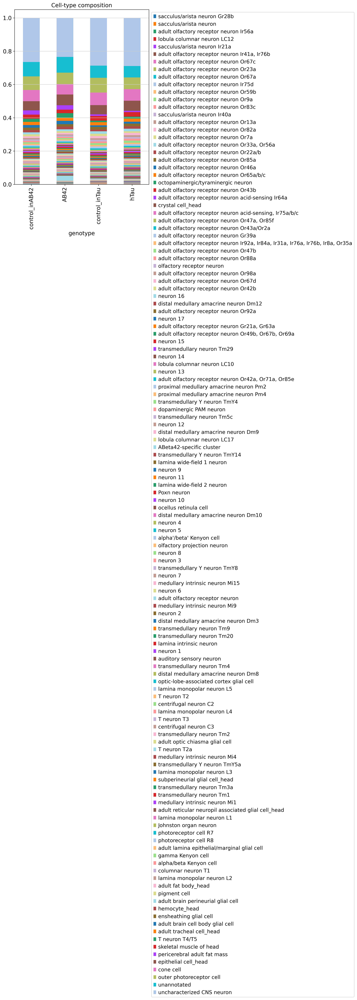

In [40]:
ratioDf=pd.DataFrame(index=annotationGeno_Df.index.to_list(), columns=[genotype + '_ratio' for genotype in annotationGeno_Df.columns[1:]])
for genotype in annotationGeno_Df.columns[1:]:
    print(genotype)
    ratioDf[f'{genotype}_ratio'] = ( annotationGeno_Df[f'{genotype}']/sum(annotationGeno_Df[f'{genotype}']) )
ratioDf = ratioDf.sort_values(by=[ f'{annotationGeno_Df.columns[1]}_ratio' ])
ratioDf

ratioT_Df=ratioDf.transpose()
# ratioT_Df.insert(0, 'genoAge', genoAge_L)
ratioT_Df.insert(0, 'genotype', annotationGeno_Df.columns[1:].to_list())
ratioT_Df

with rc_context({'figure.figsize': (6, 8)}): 
    ax=ratioT_Df.plot(
        x = 'genotype',
        kind = 'bar',
        stacked = True,
        title = 'Cell-type composition'
    )
    ax.grid(axis='x',visible=False)
    # plt.legend(loc='lower right')
    plt.legend(bbox_to_anchor=(1.0, 1.0))
    plt.tight_layout()
    plt.savefig(f'{olfAnnotPicFolder}/{adfcaTissue}_barplot_genotypeGroup_cellRatio.pdf')
    plt.show()


### Relative ratio (normalize to control, separated by genotype group)
Filter cell types with cellN <700

In [41]:
genoCompare_D = dict(zip(genoCompare_Df.expSet, genoCompare_Df.controlSet))
genoCompare_D

{'AB42': 'control_inAB42', 'hTau': 'control_inTau'}

In [42]:
ratioDf

,control_inAB42_ratio,AB42_ratio,control_inTau_ratio,hTau_ratio
sacculus/arista neuron Gr28b,0.000043,0.000022,0.000019,0.000038
sacculus/arista neuron,0.000061,0.000054,0.000113,0.000142
adult olfactory receptor neuron Ir56a,0.000078,0.000086,0.000085,0.000123
lobula columnar neuron LC12,0.000078,0.000054,0.000075,0.000076
sacculus/arista neuron Ir21a,0.000078,0.000043,0.000123,0.000133
...,...,...,...,...
epithelial cell_head,0.055122,0.064176,0.055070,0.060683
cone cell,0.067519,0.063120,0.075398,0.069840
outer photoreceptor cell,0.081963,0.068282,0.088925,0.069849
unannotated,0.086312,0.094545,0.072775,0.068652


In [43]:
normalRatio_Df=ratioDf[:]
normalRatio_Df=normalRatio_Df.drop(['unannotated', 'uncharacterized CNS neuron'], axis=0)

### without selecting celltypeN700_L
# normalRatio_Df=normalRatio_Df[normalRatio_Df.index.isin(celltypeN700_L)]

    
for expSet in genoCompare_Df.expSet:
    controlSet = genoCompare_D[expSet]
    print(expSet, controlSet)
    normalRatio_Df[f'{expSet}/{controlSet}_ratio']=normalRatio_Df[f'{expSet}_ratio']/normalRatio_Df[f'{controlSet}_ratio']

normalRatio_Df=normalRatio_Df.iloc[:,4:]
normalRatioNoLog2_Df=normalRatio_Df[:]
normalRatio_Df=np.log2(normalRatio_Df)

normalRatioNoLog2_Df=normalRatioNoLog2_Df.sort_values(by=f'{genoCompare_Df.iloc[0,0]}/{genoCompare_Df.iloc[0,1]}_ratio', ascending=False)
normalRatio_Df=normalRatio_Df.sort_values(by=f'{genoCompare_Df.iloc[0,0]}/{genoCompare_Df.iloc[0,1]}_ratio', ascending=False)

normalRatio_Df.replace([np.inf, -np.inf], np.nan, inplace=True)
normalRatioNoLog2_Df.replace([np.inf, -np.inf], np.nan, inplace=True)

normalRatio_Df

AB42 control_inAB42
hTau control_inTau


,AB42/control_inAB42_ratio,hTau/control_inTau_ratio
ABeta42-specific cluster,4.414011,-0.690243
adult olfactory receptor neuron Ir75d,1.151579,0.829356
T neuron T4/T5,0.536971,0.397971
alpha'/beta' Kenyon cell,0.485375,0.547585
neuron 6,0.447464,0.287913
...,...,...
adult olfactory receptor neuron Or46a,-1.594847,-0.437531
transmedullary neuron Tm29,-1.598689,-0.088636
adult olfactory receptor neuron Or42b,-1.787492,-0.253107
adult olfactory receptor neuron Or43b,-2.190457,-0.346216


In [44]:
normalRatio_Df.insert(0, 'annotation', normalRatio_Df.index.to_list())
normalRatio_longDf=normalRatio_Df.melt(id_vars=['annotation'], var_name='genotypeCompare', value_name='log2ratio')
normalRatio_longDf

,annotation,genotypeCompare,log2ratio
0,ABeta42-specific cluster,AB42/control_inAB42_ratio,4.414011
1,adult olfactory receptor neuron Ir75d,AB42/control_inAB42_ratio,1.151579
2,T neuron T4/T5,AB42/control_inAB42_ratio,0.536971
3,alpha'/beta' Kenyon cell,AB42/control_inAB42_ratio,0.485375
4,neuron 6,AB42/control_inAB42_ratio,0.447464
...,...,...,...
251,adult olfactory receptor neuron Or46a,hTau/control_inTau_ratio,-0.437531
252,transmedullary neuron Tm29,hTau/control_inTau_ratio,-0.088636
253,adult olfactory receptor neuron Or42b,hTau/control_inTau_ratio,-0.253107
254,adult olfactory receptor neuron Or43b,hTau/control_inTau_ratio,-0.346216


In [45]:
olfNormalRatio_Df = normalRatio_Df[ [True if 'olfactory' in annot else False for annot in normalRatio_Df.annotation ] ]
olfNormalRatio_Df.sort_values(by='AB42/control_inAB42_ratio', ascending=True, inplace=True)

olfNormalRatio_longDf=olfNormalRatio_Df.melt(id_vars=['annotation'], var_name='genotypeCompare', value_name='log2ratio')
olfNormalRatio_Df

/tmp/ipykernel_3626266/4258244991.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  olfNormalRatio_Df.sort_values(by='AB42/control_inAB42_ratio', ascending=True, inplace=True)


,annotation,AB42/control_inAB42_ratio,hTau/control_inTau_ratio
adult olfactory receptor neuron Or7a,adult olfactory receptor neuron Or7a,-2.746850,-0.243829
adult olfactory receptor neuron Or43b,adult olfactory receptor neuron Or43b,-2.190457,-0.346216
adult olfactory receptor neuron Or42b,adult olfactory receptor neuron Or42b,-1.787492,-0.253107
adult olfactory receptor neuron Or46a,adult olfactory receptor neuron Or46a,-1.594847,-0.437531
"adult olfactory receptor neuron Gr21a, Gr63a","adult olfactory receptor neuron Gr21a, Gr63a",-1.404164,-0.019219
adult olfactory receptor neuron Or13a,adult olfactory receptor neuron Or13a,-1.340033,-1.990072
"adult olfactory receptor neuron Or33a, Or56a","adult olfactory receptor neuron Or33a, Or56a",-1.331813,-0.298195
adult olfactory receptor neuron Or92a,adult olfactory receptor neuron Or92a,-1.190457,-0.693090
"adult olfactory receptor neuron acid-sensing, Ir75a/b/c","adult olfactory receptor neuron acid-sensing, ...",-1.128529,0.259906
adult olfactory receptor neuron Or83c,adult olfactory receptor neuron Or83c,-1.080274,-0.642149


In [46]:
cellN100_L = annotationGeno_Df[annotationGeno_Df.TotalCellN > 100].index.to_list()
# cellN100_L

In [47]:
olfNormalRatio_longDf

,annotation,genotypeCompare,log2ratio
0,adult olfactory receptor neuron Or7a,AB42/control_inAB42_ratio,-2.746850
1,adult olfactory receptor neuron Or43b,AB42/control_inAB42_ratio,-2.190457
2,adult olfactory receptor neuron Or42b,AB42/control_inAB42_ratio,-1.787492
3,adult olfactory receptor neuron Or46a,AB42/control_inAB42_ratio,-1.594847
4,"adult olfactory receptor neuron Gr21a, Gr63a",AB42/control_inAB42_ratio,-1.404164
...,...,...,...
67,"adult olfactory receptor neuron Ir92a, Ir84a, ...",hTau/control_inTau_ratio,0.228108
68,adult olfactory receptor neuron Or67d,hTau/control_inTau_ratio,0.174315
69,adult olfactory receptor neuron Ir56a,hTau/control_inTau_ratio,0.540442
70,"adult olfactory receptor neuron Ir41a, Ir76b",hTau/control_inTau_ratio,-0.159997


In [68]:
olfSelect_L = olfNormalRatio_longDf[ (olfNormalRatio_longDf.annotation.isin(cellN100_L)) &  (olfNormalRatio_longDf.log2ratio <0) & (olfNormalRatio_longDf.annotation != 'olfactory projection neuron') ].annotation.to_list()[:5]
orfNegative_L = olfNormalRatio_longDf[ (olfNormalRatio_longDf.annotation.isin(cellN100_L)) &  (olfNormalRatio_longDf.log2ratio <0) & (olfNormalRatio_longDf.annotation != 'olfactory projection neuron') ].annotation.to_list()

In [69]:
olfNormalRatio_longDf

,annotation,genotypeCompare,log2ratio
0,adult olfactory receptor neuron Or7a,AB42/control_inAB42_ratio,-2.746850
1,adult olfactory receptor neuron Or43b,AB42/control_inAB42_ratio,-2.190457
2,adult olfactory receptor neuron Or42b,AB42/control_inAB42_ratio,-1.787492
3,adult olfactory receptor neuron Or46a,AB42/control_inAB42_ratio,-1.594847
4,"adult olfactory receptor neuron Gr21a, Gr63a",AB42/control_inAB42_ratio,-1.404164
...,...,...,...
67,"adult olfactory receptor neuron Ir92a, Ir84a, ...",hTau/control_inTau_ratio,0.228108
68,adult olfactory receptor neuron Or67d,hTau/control_inTau_ratio,0.174315
69,adult olfactory receptor neuron Ir56a,hTau/control_inTau_ratio,0.540442
70,"adult olfactory receptor neuron Ir41a, Ir76b",hTau/control_inTau_ratio,-0.159997


/tmp/ipykernel_3626266/726249554.py:7: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


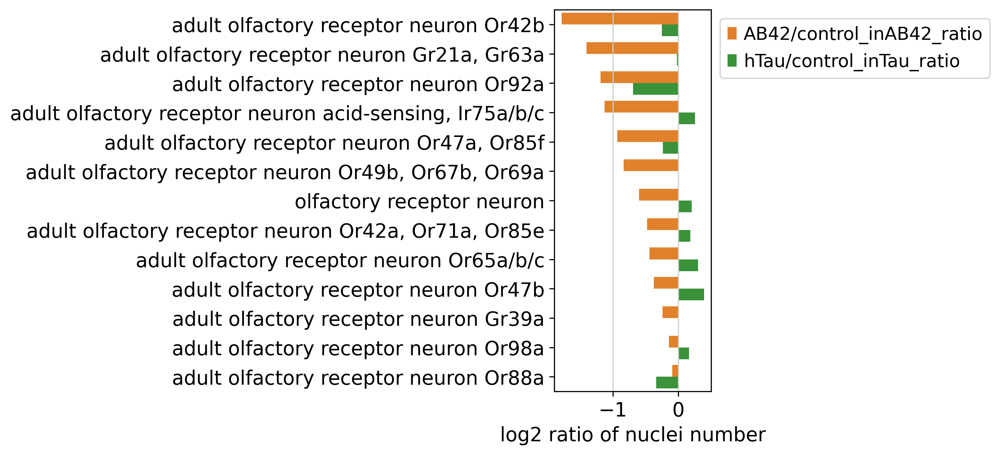

In [70]:
fig, ax = plt.subplots(figsize=(2, 5))
sns.barplot(x='log2ratio', y='annotation', hue='genotypeCompare', data=olfNormalRatio_longDf[ olfNormalRatio_longDf.annotation.isin(orfNegative_L)], palette=sns.color_palette("tab10")[1:3], ax=ax) # (olfNormalRatio_longDf.genotypeCompare == 'AB42/control_inAB42_ratio') &
plt.legend(bbox_to_anchor=(1.0, 1.0))
# plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.tight_layout()
plt.savefig(f'{olfAnnotPicFolder}/barplot_cellRatio_genotype_cellN100_down.pdf', bbox_inches='tight')

/tmp/ipykernel_3626266/9366069.py:9: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


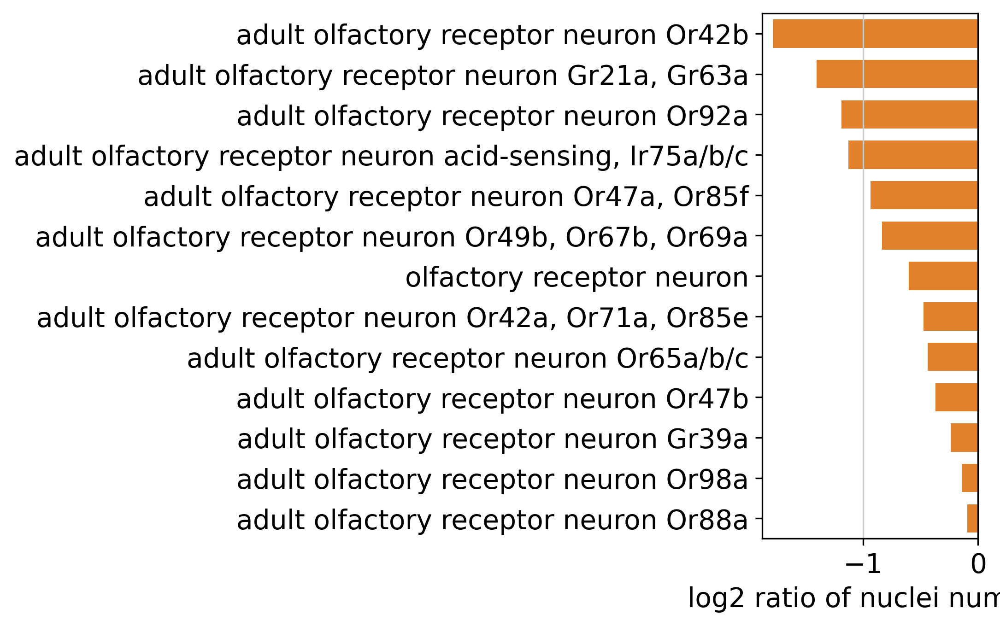

In [71]:
fig, ax = plt.subplots(figsize=(2, 5))
sns.barplot(x='log2ratio', y='annotation', hue='genotypeCompare', width=0.7,
            data=olfNormalRatio_longDf[ (olfNormalRatio_longDf.annotation.isin(orfNegative_L)) & (olfNormalRatio_longDf.genotypeCompare != 'hTau/control_inTau_ratio') ], 
            palette=sns.color_palette("tab10")[1:3], ax=ax) # (olfNormalRatio_longDf.genotypeCompare == 'AB42/control_inAB42_ratio') &
plt.legend(bbox_to_anchor=(1.0, 1.0))
# plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.tight_layout()
ax.get_legend().remove()
plt.savefig(f'{olfAnnotPicFolder}/barplot_cellRatio_genotype_cellN100_down_noTau.pdf', bbox_inches='tight')

/tmp/ipykernel_3626266/373835671.py:9: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


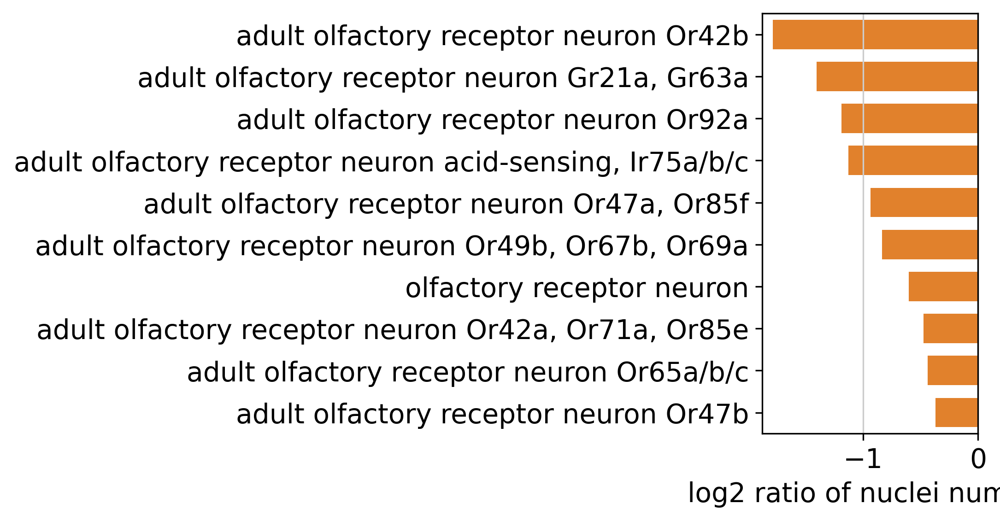

In [77]:
fig, ax = plt.subplots(figsize=(2, 4))
sns.barplot(x='log2ratio', y='annotation', hue='genotypeCompare', width=0.7,
            data=olfNormalRatio_longDf[ (olfNormalRatio_longDf.annotation.isin(orfNegative_L)) & (olfNormalRatio_longDf.genotypeCompare != 'hTau/control_inTau_ratio') ].iloc[:10,:], 
            palette=sns.color_palette("tab10")[1:3], ax=ax) # (olfNormalRatio_longDf.genotypeCompare == 'AB42/control_inAB42_ratio') &
plt.legend(bbox_to_anchor=(1.0, 1.0))
# plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.tight_layout()
ax.get_legend().remove()
plt.savefig(f'{olfAnnotPicFolder}/barplot_cellRatio_genotype_cellN100_down10_noTau.pdf', bbox_inches='tight')

/tmp/ipykernel_3626266/1644658875.py:7: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


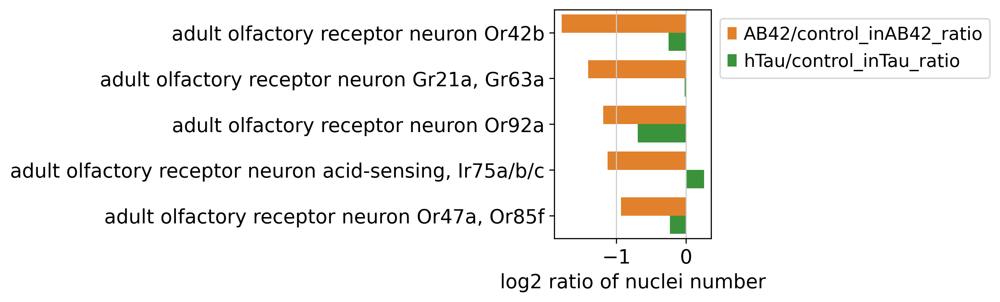

In [65]:
fig, ax = plt.subplots(figsize=(2, 3))
sns.barplot(x='log2ratio', y='annotation', hue='genotypeCompare', data=olfNormalRatio_longDf[ olfNormalRatio_longDf.annotation.isin(olfSelect_L)], palette=sns.color_palette("tab10")[1:3], ax=ax) # (olfNormalRatio_longDf.genotypeCompare == 'AB42/control_inAB42_ratio') &
plt.legend(bbox_to_anchor=(1.0, 1.0))
# plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
plt.ylabel('')
plt.tight_layout()
plt.savefig(f'{olfAnnotPicFolder}/barplot_cellRatio_genotype_cellN100_downTop5.pdf', bbox_inches='tight')

/tmp/ipykernel_3626266/2244046001.py:9: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


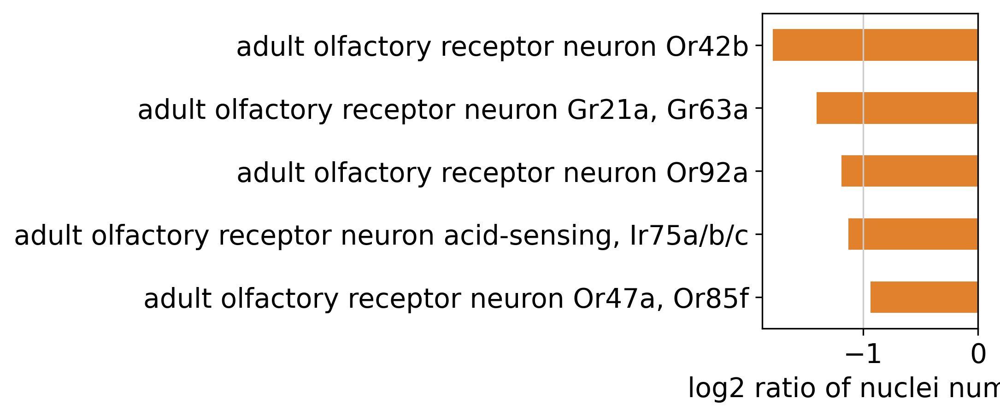

In [66]:
fig, ax = plt.subplots(figsize=(2, 3))
sns.barplot(x='log2ratio', y='annotation', hue='genotypeCompare', width=0.5,
            data=olfNormalRatio_longDf[ (olfNormalRatio_longDf.annotation.isin(olfSelect_L)) & (olfNormalRatio_longDf.genotypeCompare != 'hTau/control_inTau_ratio') ], palette=sns.color_palette("tab10")[1:3], ax=ax) # (olfNormalRatio_longDf.genotypeCompare == 'AB42/control_inAB42_ratio') &
plt.legend(bbox_to_anchor=(1.0, 1.0))
# plt.xlim(-1.6, 1.6)
plt.xlabel('log2 ratio of nuclei number')
ax.get_legend().remove()
plt.ylabel('')
plt.tight_layout()
plt.savefig(f'{olfAnnotPicFolder}/barplot_cellRatio_genotype_cellN100_downTop5_noTau.pdf', bbox_inches='tight')

In [57]:
annotationDf.to_csv(f'{cellnFolder}/{adfcaTissue}_cellN_genotypeGroup.csv')

In [60]:
ratioDf.to_csv(f'{cellnFolder}/{adfcaTissue}_ratioDf_genotypeGroup.csv')
# dotplot_Df.to_csv(f'{cellnFolder}/{adfcaTissue}_ratioDf_dotplot_Df_genotypeGroup.csv')

In [61]:
olfNormalRatio_Df.to_csv(f'{cellnFolder}/{adfcaTissue}_olfNormalRatio_Df_normalizeToControl_genotypeGroup.csv')

# check expression of each OR

## Load data

In [20]:
adata_adfca_olf = sc.read(f'{olfAnnotFolder}/olfactory_7.adata_adfca_olf_subset_adfca_annotation_olfactory.h5ad')
adata_head = sc.read('/data/tcl/Project/ADFCA/adataProcess/v0.4/adfca_head_v0.4_woHarmony_olfactory.h5ad')

In [22]:
adata_adfca_olf.obs.adfca_annotation_olfactory.value_counts()

adult olfactory receptor neuron                                                   1120
adult olfactory receptor neuron Or42a, Or71a, Or85e                                394
adult olfactory receptor neuron Or49b, Or67b, Or69a                                236
adult olfactory receptor neuron Or67d                                              188
adult olfactory receptor neuron Or98a                                              184
adult olfactory receptor neuron Or47b                                              165
adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a     164
adult olfactory receptor neuron Or92a                                              163
adult olfactory receptor neuron Or88a                                              158
olfactory receptor neuron                                                          156
adult olfactory receptor neuron Gr21a, Gr63a                                       149
adult olfactory receptor neuron Gr39a      

## dotplot for all receptor

In [70]:
gene_D = {}
for celltype in adata_adfca_olf.obs.adfca_annotation_olfactory.cat.categories:
    if celltype not in ['adult olfactory receptor neuron', 'sacculus/arista neuron']:
        adata = adata_adfca_olf[adata_adfca_olf.obs.adfca_annotation_olfactory == celltype]
        
        if 'adult olfactory receptor neuron' in celltype:
            if 'acid-sensing' not in celltype:
                if '/' not in celltype:
                    gene_L = celltype.split('adult olfactory receptor neuron ')[-1].split(', ')
                    # print(celltype)
                    # print(gene_L)
                else:
                    firstGene = celltype.split('adult olfactory receptor neuron ')[-1].split(', ')[-1].split('/')[0]
                    genePrfix = firstGene[:-1]
                    gene_L = [firstGene] + [genePrfix + suffix for suffix in celltype.split('adult olfactory receptor neuron ')[-1].split(', ')[-1].split('/')[1:] ]
                    # print(celltype)
                    # print(gene_L)
            else:
                if ',' not in celltype: firstGene = celltype.split('adult olfactory receptor neuron acid-sensing ')[-1].split('/')[0]
                else: firstGene = celltype.split('adult olfactory receptor neuron acid-sensing')[-1].split(', ')[-1].split('/')[0]
                    
                genePrfix = firstGene[:-1]
                gene_L = [firstGene] + [genePrfix + suffix for suffix in celltype.split('adult olfactory receptor neuron acid-sensing')[-1].split(', ')[-1].split('/')[1:] ]
                # print(celltype)
                # print(gene_L)
        else:
            gene_L = [celltype.split('sacculus/arista neuron ')[-1]]
            # print(celltype)
            # print(gene_L)
            
        gene_D[celltype] = gene_L
print(gene_D)

{'adult olfactory receptor neuron Gr21a, Gr63a': ['Gr21a', 'Gr63a'], 'adult olfactory receptor neuron Gr39a': ['Gr39a'], 'adult olfactory receptor neuron Ir41a, Ir76b': ['Ir41a', 'Ir76b'], 'adult olfactory receptor neuron Ir56a': ['Ir56a'], 'adult olfactory receptor neuron Ir75d': ['Ir75d'], 'adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a': ['Ir92a', 'Ir84a', 'Ir31a', 'Ir76a', 'Ir76b', 'Ir8a', 'Or35a'], 'adult olfactory receptor neuron Or13a': ['Or13a'], 'adult olfactory receptor neuron Or22a/b': ['Or22a', 'Or22b'], 'adult olfactory receptor neuron Or23a': ['Or23a'], 'adult olfactory receptor neuron Or33a, Or56a': ['Or33a', 'Or56a'], 'adult olfactory receptor neuron Or42a, Or71a, Or85e': ['Or42a', 'Or71a', 'Or85e'], 'adult olfactory receptor neuron Or42b': ['Or42b'], 'adult olfactory receptor neuron Or43a, Or2a': ['Or43a', 'Or2a'], 'adult olfactory receptor neuron Or43b': ['Or43b'], 'adult olfactory receptor neuron Or46a': ['Or46a'], 'adult olfactory rec

In [73]:
coreceptor_L = ['Orco', 'Ir25a', 'Ir76b', 'Ir8a']
for celltype in list(gene_D.keys())[:]:
    print(celltype)
    celltypeName = '_'.join(celltype.split('/'))
    adata = adata_adfca_olf[adata_adfca_olf.obs.adfca_annotation_olfactory == celltype]
    sc.pl.dotplot(adata, var_names=gene_D[celltype]+coreceptor_L, groupby='genotype', title=f'{celltype}_nuclei#:{len(adata)}', 
                  show=False, save=f'_{celltypeName}.pdf') # 'CG43689', 

adult olfactory receptor neuron Gr21a, Gr63a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Gr39a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir41a, Ir76b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir56a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir75d


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Ir92a, Ir84a, Ir31a, Ir76a, Ir76b, Ir8a, Or35a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or13a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or22a/b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or23a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or33a, Or56a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or42a, Or71a, Or85e


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or42b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or43a, Or2a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or43b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or46a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or47a, Or85f


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or47b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or49b, Or67b, Or69a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or59b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or65a/b/c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or67d


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or7a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or82a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or83c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or85a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or88a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or92a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or98a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron Or9a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron acid-sensing Ir64a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


adult olfactory receptor neuron acid-sensing, Ir75a/b/c


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Gr28b


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Ir21a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


sacculus/arista neuron Ir40a


/data/tcl/miniconda3/envs/scanpy182/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


# Finish